# Exploratory Data Analysis - Point In Time Count (PIT) Dataset

### Team member - Samritha Aadhi Ravikumar

In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import plotly.express as px

In [2]:
# Load the Dataset
file_path = '/Users/samritha/Downloads/final_homeless_dataset.csv'  
df = pd.read_csv(file_path)
df.head()

,CoC Number,CoC Name,CoC Category,Count Types,Homelessness.Type,Count,Year
0,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Overall.Homeless,974,2007
1,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Sheltered.Total.Homeless,842,2007
2,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Unsheltered.Homeless,132,2007
3,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Overall.Homeless.Individuals,696,2007
4,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Overall.Homeless.People.in.Families,278,2007


In [3]:
## Dataset Overview

# The shape of the dataset
print("Shape of the dataset:", df.shape)

# Information about the dataset
print("Dataset Info:")
df.info()

# Statistics Summary for numerical columns
print("\nStatistics Summary for numerical columns:")
df.describe()

Shape of the dataset: (32580, 7)
Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32580 entries, 0 to 32579
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   CoC Number         32580 non-null  object
 1   CoC Name           32580 non-null  object
 2   CoC Category       32225 non-null  object
 3   Count Types        28690 non-null  object
 4   Homelessness.Type  32580 non-null  object
 5   Count              32580 non-null  int64 
 6   Year               32580 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 1.7+ MB

Statistics Summary for numerical columns:


,Count,Year
count,32580.000000,32580.000000
mean,915.941743,2015.017035
std,3074.675315,4.903018
min,0.000000,2007.000000
25%,140.000000,2011.000000
50%,341.000000,2015.000000
75%,842.000000,2019.000000
max,88025.000000,2023.000000


In [4]:
# Check for Null Values
print("\nMissing values in the dataset:")
print(df.isnull().sum())


Missing values in the dataset:
CoC Number              0
CoC Name                0
CoC Category          355
Count Types          3890
Homelessness.Type       0
Count                   0
Year                    0
dtype: int64


In [5]:
# Check for Duplicates
print("\nNumber of duplicate rows:", df.duplicated().sum())


Number of duplicate rows: 0


In [6]:
# Check for Count Type Distribution
df['Count Types'].value_counts()

Count Types
Sheltered and Unsheltered Count            24895
Sheltered-Only Count                        2885
No 2010 PIT Count                            425
Sheltered and Partial Unsheltered Count      375
Sheltered-Only Count*                        110
Name: count, dtype: int64

In [7]:
# Check for CoC Category Distribution
df['CoC Category'].value_counts()

CoC Category
Largely Suburban CoC       14065
Largely Rural CoC           9130
Other Largely Urban CoC     4865
Major City CoC              4165
Name: count, dtype: int64

In [8]:
# Check Data Range of Numerical Columns
print("\nData ranges for numerical columns:")
for col in df.select_dtypes(include=['float64', 'int64']).columns:
    print(f"{col}: Min = {df[col].min()}, Max = {df[col].max()}")


Data ranges for numerical columns:
Count: Min = 0, Max = 88025
Year: Min = 2007, Max = 2023


In [9]:
# Check Unique Values in Categorical Columns
categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()

print("\nUnique values in each categorical column:")
for col in categorical_columns:
    print(f"\nColumn: {col}")
    print(df[col].unique())


Unique values in each categorical column:

Column: CoC Number
['AK-500' 'AK-501' 'AL-500' 'AL-501' 'AL-502' 'AL-503' 'AL-504' 'AL-505'
 'AL-506' 'AL-507' 'AR-500' 'AR-501' 'AR-502' 'AR-504' 'AR-505' 'AR-506'
 'AR-508' 'AR-509' 'AR-510' 'AZ-500' 'AZ-501' 'AZ-502' 'CA-500' 'CA-501'
 'CA-502' 'CA-503' 'CA-504' 'CA-505' 'CA-506' 'CA-507' 'CA-508' 'CA-509'
 'CA-510' 'CA-511' 'CA-512' 'CA-513' 'CA-514' 'CA-515' 'CA-516' 'CA-517'
 'CA-518' 'CA-519' 'CA-520' 'CA-521' 'CA-522' 'CA-523' 'CA-524' 'CA-525'
 'CA-526' 'CA-600' 'CA-601' 'CA-602' 'CA-603' 'CA-604' 'CA-606' 'CA-607'
 'CA-608' 'CA-609' 'CA-611' 'CA-612' 'CA-613' 'CA-614' 'CO-500' 'CO-503'
 'CO-504' 'CT-503' 'CT-505' 'DC-500' 'DE-500' 'FL-500' 'FL-501' 'FL-502'
 'FL-503' 'FL-504' 'FL-505' 'FL-506' 'FL-507' 'FL-508' 'FL-509' 'FL-510'
 'FL-511' 'FL-512' 'FL-513' 'FL-514' 'FL-515' 'FL-517' 'FL-518' 'FL-519'
 'FL-520' 'FL-600' 'FL-601' 'FL-602' 'FL-603' 'FL-604' 'FL-605' 'FL-606'
 'GA-500' 'GA-501' 'GA-503' 'GA-504' 'GA-505' 'GA-506' 'GA-50

#### Data Visualization 

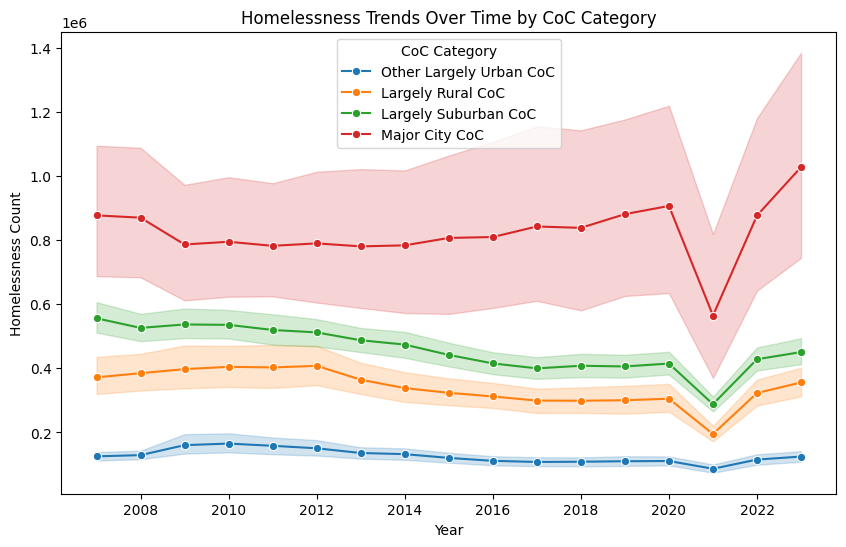

In [10]:
# Line Plot: Homeless Count by Category Over Years

plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x='Year', y='Count', hue='CoC Category',estimator='sum', marker="o")
plt.title('Homelessness Trends Over Time by CoC Category')
plt.xlabel('Year')
plt.ylabel('Homelessness Count')
plt.legend(title='CoC Category')
plt.show()

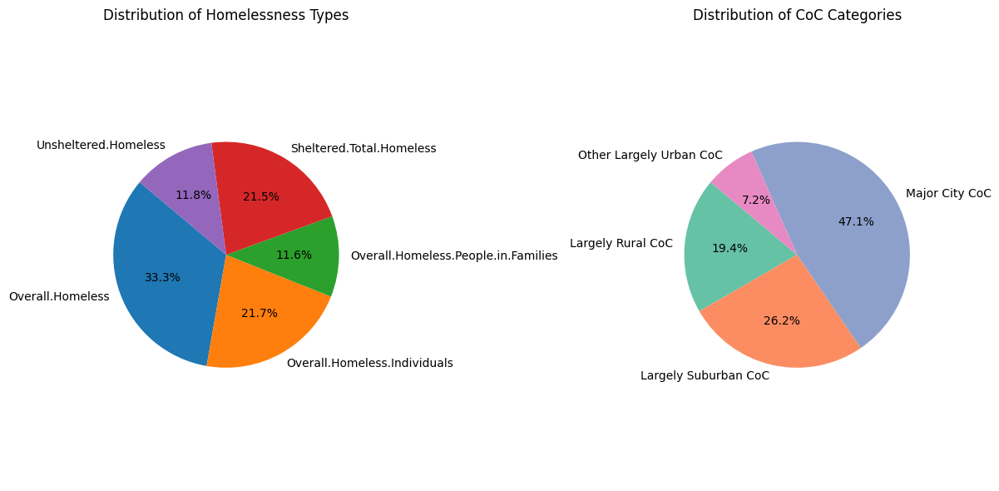

In [11]:
# Pie Chart: Comparison of Homelessness Types and Category Distribution

fig, axes = plt.subplots(1, 2, figsize=(12, 6)) 

# First Pie Chart: Distribution of Homelessness Types
homelessness_counts = df.groupby('Homelessness.Type')['Count'].sum()
axes[0].pie(homelessness_counts, labels=homelessness_counts.index, autopct='%1.1f%%', startangle=140)
axes[0].set_title('Distribution of Homelessness Types')
axes[0].axis('equal') 

# Second Pie Chart: Distribution of CoC Categories
df_category = df[df['Homelessness.Type'] == 'Overall.Homeless'].groupby('CoC Category')['Count'].sum()
axes[1].pie(df_category, labels=df_category.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('Set2'))
axes[1].set_title('Distribution of CoC Categories')
axes[1].axis('equal')

plt.tight_layout()
plt.show()

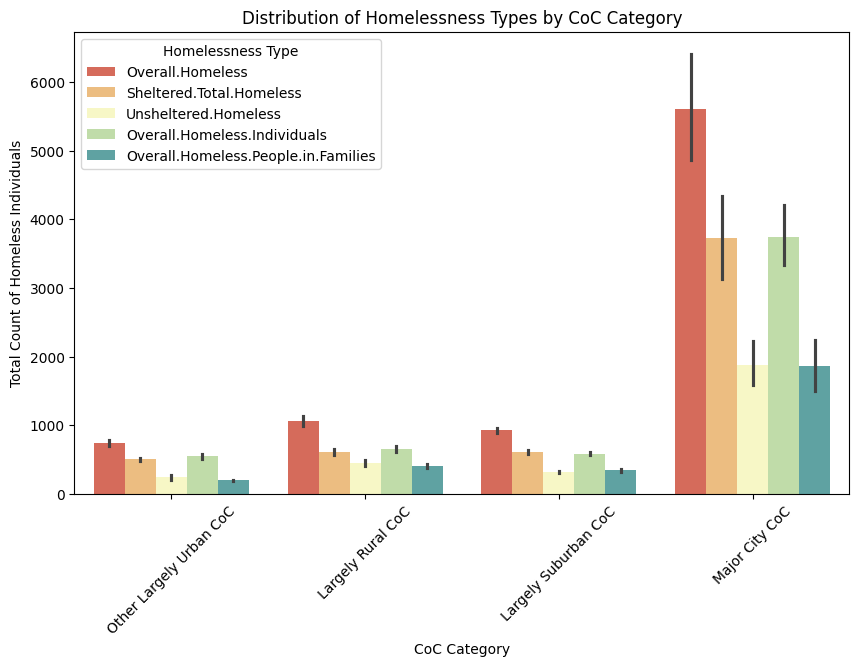

In [12]:
# Grouped Bar Plot: Total Homelessness Count by Category

plt.figure(figsize=(10, 6))
sns.barplot(data=df, x='CoC Category', y='Count', hue='Homelessness.Type', palette='Spectral')
plt.title('Distribution of Homelessness Types by CoC Category')
plt.xlabel('CoC Category')
plt.ylabel('Total Count of Homeless Individuals')
plt.xticks(rotation=45)
plt.legend(title='Homelessness Type')
plt.xticks(rotation=45)
plt.show()

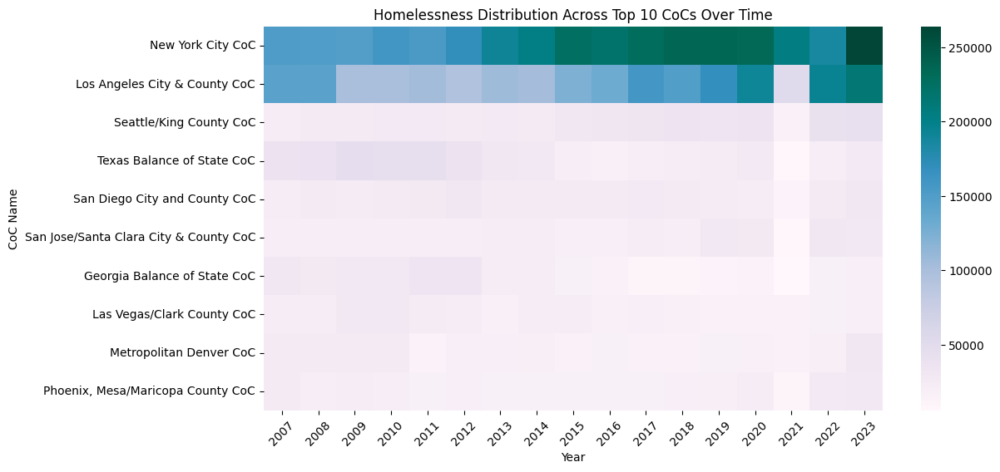

In [13]:
# HeatMap: Homelessness Distribution Across Top 10 CoCs Over Time

coc_total_counts = df.groupby('CoC Name')['Count'].sum().reset_index()
top_10_cocs = coc_total_counts.nlargest(10, 'Count')['CoC Name']
df_top_10 = df[df['CoC Name'].isin(top_10_cocs)]
pivot_table = df_top_10.pivot_table(values='Count', index='CoC Name', columns='Year', aggfunc='sum', fill_value=0)
pivot_table = pivot_table.loc[pivot_table.sum(axis=1).sort_values(ascending=False).index]
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, cmap='PuBuGn')
plt.title('Homelessness Distribution Across Top 10 CoCs Over Time')
plt.xlabel('Year')
plt.ylabel('CoC Name')
plt.xticks(rotation=45)
plt.show()

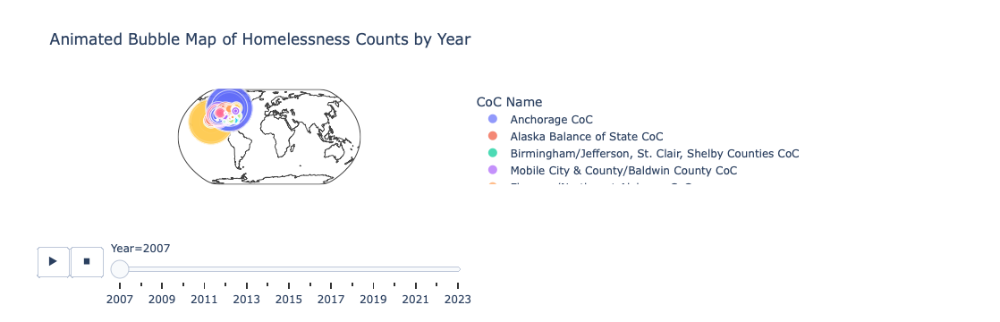

In [14]:
# Bubble Map: Homelessness Count in CoCs

np.random.seed(42)  
unique_names = df['CoC Name'].unique()
coordinates = {name: (np.random.uniform(low=25.0, high=50.0), np.random.uniform(low=-125.0, high=-66.0)) for name in unique_names}

df['Latitude'] = df['CoC Name'].map(lambda x: coordinates[x][0])
df['Longitude'] = df['CoC Name'].map(lambda x: coordinates[x][1])

fig = px.scatter_geo(df,
                     lat='Latitude',
                     lon='Longitude',
                     size='Count',
                     color='CoC Name',
                     hover_name='CoC Name',
                     animation_frame='Year',
                     projection='natural earth',
                     title='Animated Bubble Map of Homelessness Counts by Year',
                     size_max=50,
                     template='plotly_white')
fig.show()

### Team member - Syeda Aqeel

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [16]:
file_path = '/Users/samritha/Downloads/final_homeless_dataset.csv'  
df = pd.read_csv(file_path)

In [17]:
df.isnull().sum()

CoC Number              0
CoC Name                0
CoC Category          355
Count Types          3890
Homelessness.Type       0
Count                   0
Year                    0
dtype: int64

In [18]:
df['Count Types'].value_counts()

Count Types
Sheltered and Unsheltered Count            24895
Sheltered-Only Count                        2885
No 2010 PIT Count                            425
Sheltered and Partial Unsheltered Count      375
Sheltered-Only Count*                        110
Name: count, dtype: int64

In [19]:
df['CoC Category'].value_counts()

CoC Category
Largely Suburban CoC       14065
Largely Rural CoC           9130
Other Largely Urban CoC     4865
Major City CoC              4165
Name: count, dtype: int64

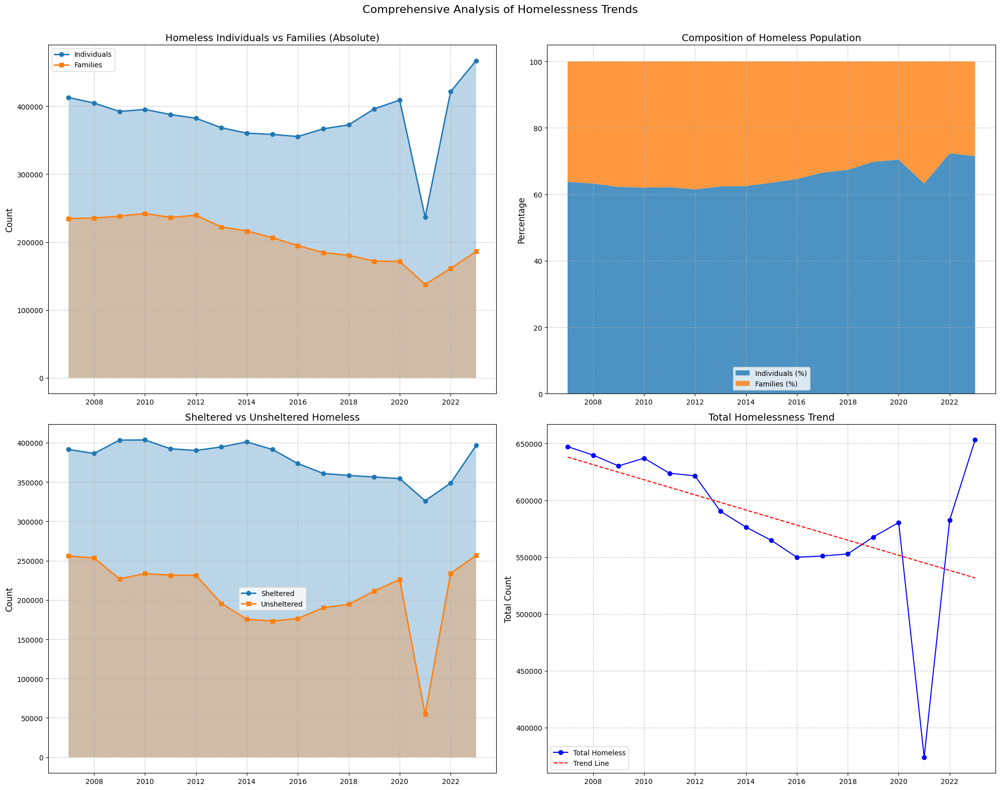

Average annual change in total homelessness: 365.38
Correlation between individuals and families: 0.33
Percentage change in homelessness from 2007 to 2023: 0.90%
Year with highest homelessness: 2023
Year with lowest homelessness: 2021


In [20]:
# Homelessness Trends: Overall, Individuals, Families, Unsheltered and Shelter Status

from scipy import stats

individuals = df[df['Homelessness.Type'] == 'Overall.Homeless.Individuals'].groupby('Year')['Count'].sum()
families = df[df['Homelessness.Type'] == 'Overall.Homeless.People.in.Families'].groupby('Year')['Count'].sum()
sheltered = df[df['Homelessness.Type'] == 'Sheltered.Total.Homeless'].groupby('Year')['Count'].sum()
unsheltered = df[df['Homelessness.Type'] == 'Unsheltered.Homeless'].groupby('Year')['Count'].sum()

total = individuals + families
individuals_pct = individuals / total * 100
families_pct = families / total * 100
sheltered_pct = sheltered / (sheltered + unsheltered) * 100
unsheltered_pct = unsheltered / (sheltered + unsheltered) * 100

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))
fig.suptitle('Comprehensive Analysis of Homelessness Trends', fontsize=16)

ax1.plot(individuals.index, individuals.values, marker='o', linewidth=2, label='Individuals')
ax1.plot(families.index, families.values, marker='s', linewidth=2, label='Families')
ax1.fill_between(individuals.index, individuals.values, alpha=0.3)
ax1.fill_between(families.index, families.values, alpha=0.3)
ax1.set_title('Homeless Individuals vs Families (Absolute)', fontsize=14)
ax1.set_ylabel('Count', fontsize=12)
ax1.legend()
ax1.grid(True, linestyle='--', alpha=0.7)

ax2.stackplot(individuals_pct.index, individuals_pct.values, families_pct.values, 
              labels=['Individuals (%)', 'Families (%)'], alpha=0.8)
ax2.set_title('Composition of Homeless Population', fontsize=14)
ax2.set_ylabel('Percentage', fontsize=12)
ax2.legend()
ax2.grid(True, linestyle='--', alpha=0.7)

ax3.plot(sheltered.index, sheltered.values, marker='o', linewidth=2, label='Sheltered')
ax3.plot(unsheltered.index, unsheltered.values, marker='s', linewidth=2, label='Unsheltered')
ax3.fill_between(sheltered.index, sheltered.values, alpha=0.3)
ax3.fill_between(unsheltered.index, unsheltered.values, alpha=0.3)
ax3.set_title('Sheltered vs Unsheltered Homeless', fontsize=14)
ax3.set_ylabel('Count', fontsize=12)
ax3.legend()
ax3.grid(True, linestyle='--', alpha=0.7)

years = individuals.index.values
total_homeless = individuals.values + families.values
z = np.polyfit(years, total_homeless, 1)
p = np.poly1d(z)
ax4.plot(years, total_homeless, 'bo-', label='Total Homeless')
ax4.plot(years, p(years), "r--", label='Trend Line')
ax4.set_title('Total Homelessness Trend', fontsize=14)
ax4.set_ylabel('Total Count', fontsize=12)
ax4.legend()
ax4.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.subplots_adjust(top=0.93)

plt.show()

print(f"Average annual change in total homelessness: {np.mean(np.diff(total_homeless)):.2f}")
print(f"Correlation between individuals and families: {stats.pearsonr(individuals, families)[0]:.2f}")
print(f"Percentage change in homelessness from {years[0]} to {years[-1]}: {((total_homeless[-1] - total_homeless[0]) / total_homeless[0] * 100):.2f}%")
print(f"Year with highest homelessness: {years[np.argmax(total_homeless)]}")
print(f"Year with lowest homelessness: {years[np.argmin(total_homeless)]}")

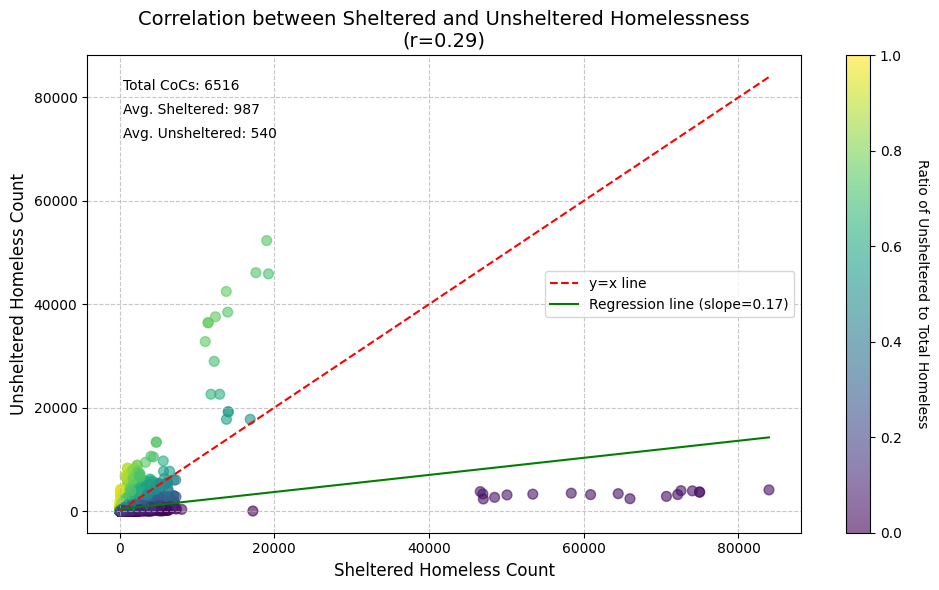

Correlation coefficient: 0.29
Regression slope: 0.17
Regression intercept: 377.26
R-squared value: 0.09
P-value: 0.0000
Average unsheltered ratio: 0.28
CoC with highest unsheltered ratio: Colusa, Glenn, Trinity Counties CoC (1.00)
CoC with lowest unsheltered ratio: St. Joseph/Andrew, Buchanan, DeKalb Counties CoC (0.00)


In [21]:
# Correlation Between Sheltered and Unsheltered Homelessness: Analysis Across CoCs

sheltered_counts = df[df['Homelessness.Type'] == 'Sheltered.Total.Homeless']
unsheltered_counts = df[df['Homelessness.Type'] == 'Unsheltered.Homeless']

correlation_df = sheltered_counts[['CoC Name', 'Count', 'Year']].merge(
    unsheltered_counts[['CoC Name', 'Count', 'Year']], 
    on=['CoC Name', 'Year'], 
    suffixes=('_sheltered', '_unsheltered')
)

correlation = correlation_df['Count_sheltered'].corr(correlation_df['Count_unsheltered'])

correlation_df['Unsheltered_Ratio'] = correlation_df['Count_unsheltered'] / (correlation_df['Count_sheltered'] + correlation_df['Count_unsheltered'])

fig, ax = plt.subplots(figsize=(10, 6))

scatter = ax.scatter(correlation_df['Count_sheltered'], 
                     correlation_df['Count_unsheltered'],
                     c=correlation_df['Unsheltered_Ratio'],
                     cmap='viridis',
                     alpha=0.6,
                     s=50)

cbar = plt.colorbar(scatter)
cbar.set_label('Ratio of Unsheltered to Total Homeless', rotation=270, labelpad=20)

ax.set_xlabel('Sheltered Homeless Count', fontsize=12)
ax.set_ylabel('Unsheltered Homeless Count', fontsize=12)
ax.set_title(f'Correlation between Sheltered and Unsheltered Homelessness\n(r={correlation:.2f})', fontsize=14)

ax.grid(True, linestyle='--', alpha=0.7)

max_count = max(correlation_df['Count_sheltered'].max(), correlation_df['Count_unsheltered'].max())
ax.plot([0, max_count], [0, max_count], 'r--', label='y=x line')

ax.text(0.05, 0.95, f'Total CoCs: {len(correlation_df)}', transform=ax.transAxes, fontsize=10, verticalalignment='top')
ax.text(0.05, 0.90, f'Avg. Sheltered: {correlation_df["Count_sheltered"].mean():.0f}', transform=ax.transAxes, fontsize=10, verticalalignment='top')
ax.text(0.05, 0.85, f'Avg. Unsheltered: {correlation_df["Count_unsheltered"].mean():.0f}', transform=ax.transAxes, fontsize=10, verticalalignment='top')

slope, intercept, r_value, p_value, std_err = stats.linregress(correlation_df['Count_sheltered'], correlation_df['Count_unsheltered'])
line = slope * np.array([0, max_count]) + intercept
ax.plot([0, max_count], line, 'g-', label=f'Regression line (slope={slope:.2f})')

ax.legend()

plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.2f}")
print(f"Regression slope: {slope:.2f}")
print(f"Regression intercept: {intercept:.2f}")
print(f"R-squared value: {r_value**2:.2f}")
print(f"P-value: {p_value:.4f}")
print(f"Average unsheltered ratio: {correlation_df['Unsheltered_Ratio'].mean():.2f}")
print(f"CoC with highest unsheltered ratio: {correlation_df.loc[correlation_df['Unsheltered_Ratio'].idxmax(), 'CoC Name']} ({correlation_df['Unsheltered_Ratio'].max():.2f})")
print(f"CoC with lowest unsheltered ratio: {correlation_df.loc[correlation_df['Unsheltered_Ratio'].idxmin(), 'CoC Name']} ({correlation_df['Unsheltered_Ratio'].min():.2f})")

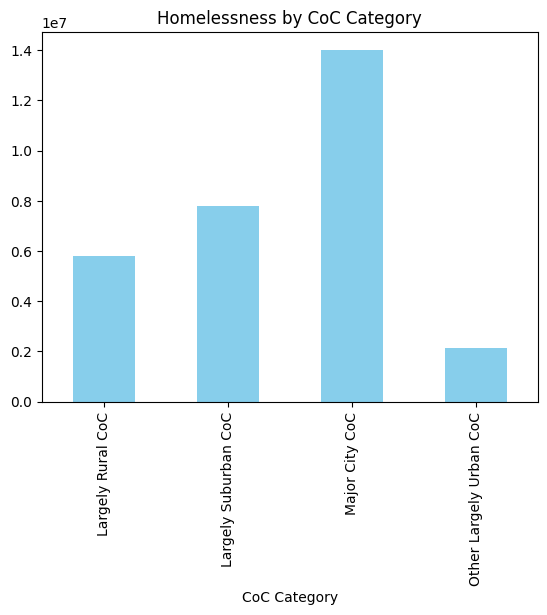

In [22]:
# Total Homelessness by CoC Category

category_group = df.groupby('CoC Category')['Count'].sum()
category_group.plot(kind='bar', color='skyblue', title='Homelessness by CoC Category') 
plt.show()

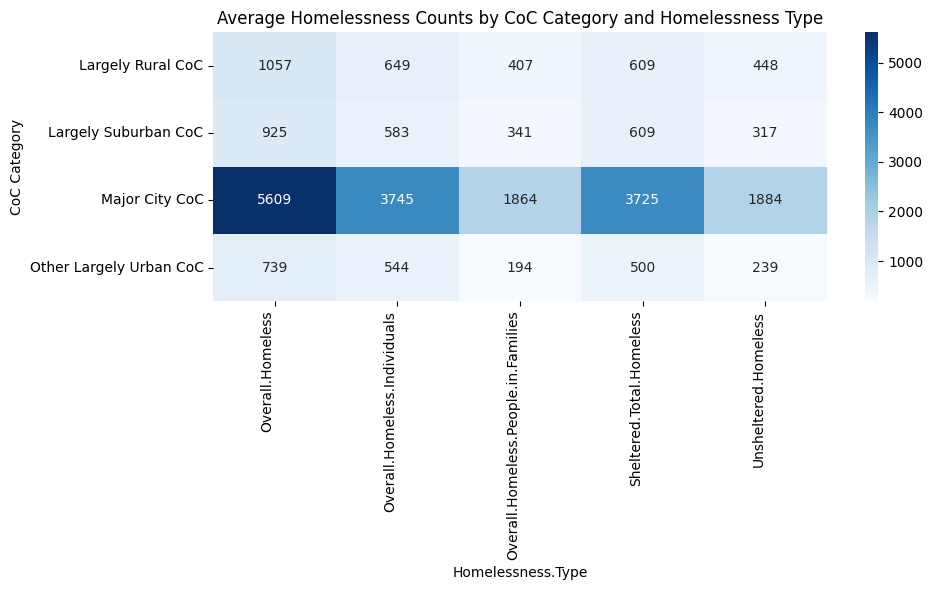

In [23]:
# Average Homelessness Counts by CoC Category and Type: Heatmap Analysis

pivot = df.pivot_table(values='Count', index='CoC Category', 
                       columns='Homelessness.Type', aggfunc='mean')

# Create a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(pivot, annot=True, cmap='Blues', fmt='.0f')
plt.title('Average Homelessness Counts by CoC Category and Homelessness Type')
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

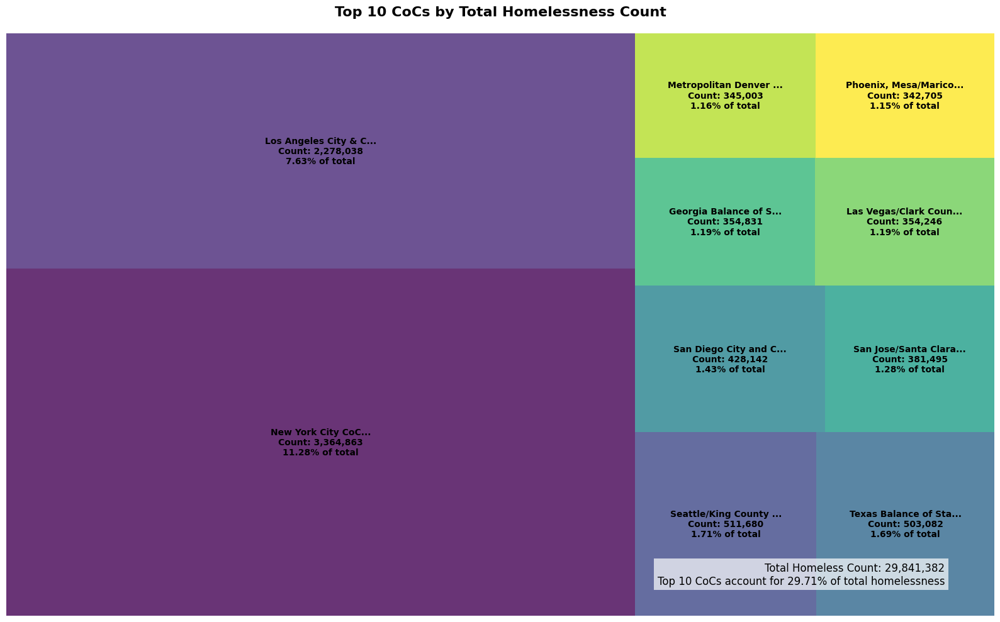

Number of CoCs: 400
Average homeless count per CoC: 74603.46
Median homeless count per CoC: 34677.00
CoC with highest homelessness: New York City CoC (3,364,863)
CoC with lowest homelessness: Hot Springs/South West Arkansas CoC (12)


In [24]:
# Top 10 CoCs by Total Homelessness Count

import squarify

coc_totals = df.groupby('CoC Name')['Count'].sum().sort_values(ascending=False)

total_homeless = coc_totals.sum()
coc_percentages = (coc_totals / total_homeless * 100).round(2)

fig, ax = plt.subplots(figsize=(16, 10))

colors = plt.cm.viridis(np.linspace(0, 1, 10))

squarify.plot(sizes=coc_totals.values[:10], 
              color=colors, 
              alpha=0.8, 
              ax=ax)

for i, (name, count, percentage) in enumerate(zip(coc_totals.index[:10], coc_totals.values[:10], coc_percentages[:10])):
    x, y, dx, dy = ax.patches[i].get_bbox().bounds
    ax.text(x + dx/2, 
            y + dy/2, 
            f"{name[:20]}...\nCount: {count:,}\n{percentage:.2f}% of total", 
            ha='center', 
            va='center', 
            fontsize=10, 
            fontweight='bold',
            wrap=True)

ax.set_title('Top 10 CoCs by Total Homelessness Count', fontsize=16, fontweight='bold', pad=20)
ax.axis('off')


summary_text = f"Total Homeless Count: {total_homeless:,}\n"
summary_text += f"Top 10 CoCs account for {coc_percentages[:10].sum():.2f}% of total homelessness"
ax.text(0.95, 0.05, summary_text, 
        horizontalalignment='right', 
        verticalalignment='bottom', 
        transform=ax.transAxes, 
        fontsize=12, 
        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

plt.tight_layout()
plt.show()

print(f"Number of CoCs: {len(coc_totals)}")
print(f"Average homeless count per CoC: {coc_totals.mean():.2f}")
print(f"Median homeless count per CoC: {coc_totals.median():.2f}")
print(f"CoC with highest homelessness: {coc_totals.index[0]} ({coc_totals.values[0]:,})")
print(f"CoC with lowest homelessness: {coc_totals.index[-1]} ({coc_totals.values[-1]:,})")

### Team member - Renjie Fan

Line chart has been saved as 'homeless_count_line_chart.png'


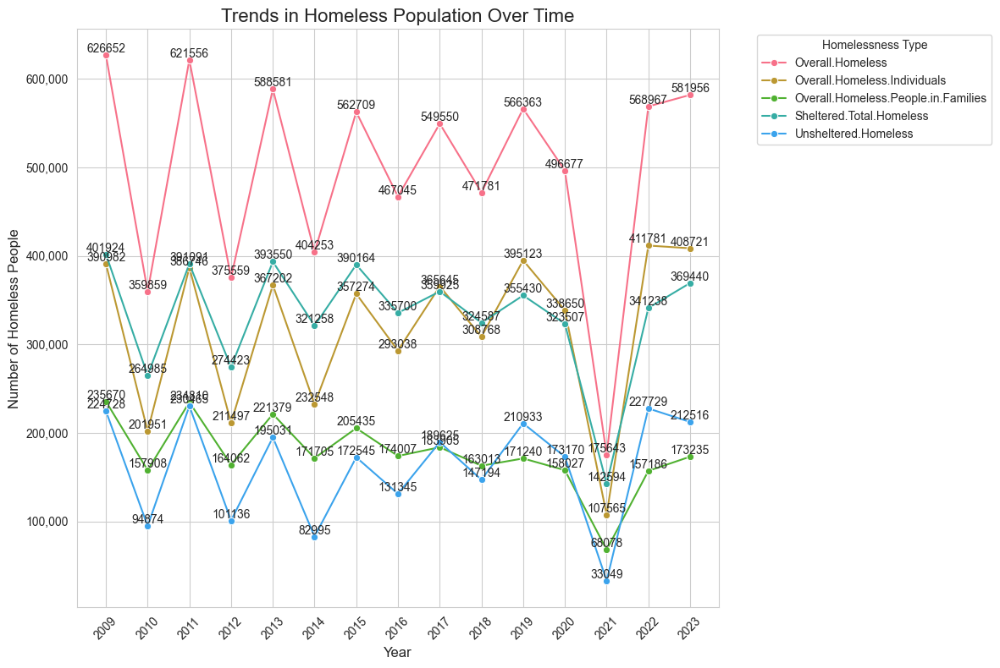

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def process_csv(file_path):
    df = pd.read_csv(file_path)
    df['Year'] = pd.to_datetime(df['Year'], format='%Y')
    
    # Select only 'Sheltered and Unsheltered Count' data
    df_filtered = df[df['Count Types'] == 'Sheltered and Unsheltered Count']
    
    # Group by year and homelessness type
    grouped = df_filtered.pivot_table(values='Count', index='Year', 
                                      columns='Homelessness.Type', aggfunc='sum')
    
    return grouped

def create_line_chart(data):
    plt.figure(figsize=(12, 8))
    
    # Use Seaborn to create a line chart
    sns.set_style("whitegrid")
    sns.set_palette("husl")

    for column in data.columns:
        sns.lineplot(x=data.index, y=data[column], label=column, marker='o')
    
    plt.title('Trends in Homeless Population Over Time', fontsize=16)
    plt.xlabel('Year', fontsize=12)
    plt.ylabel('Number of Homeless People', fontsize=12)
    plt.legend(title='Homelessness Type', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Set x-axis ticks to years
    years = data.index.year
    plt.xticks(data.index, years, rotation=45)
    
    # Add value labels to each data point
    for column in data.columns:
        for x, y in zip(data.index, data[column]):
            if pd.notna(y):
                plt.text(x, y, f'{y:.0f}', ha='center', va='bottom')

    # Set y-axis tick format
    plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))
    
    plt.tight_layout()
    plt.savefig('homeless_count_line_chart.png', dpi=300, bbox_inches='tight')
    print("Line chart has been saved as 'homeless_count_line_chart.png'")

def main():
    file_path = '/Users/samritha/Downloads/final_homeless_dataset.csv' 
    data = process_csv(file_path)
    create_line_chart(data)

if __name__ == "__main__":
    main()

/var/folders/j_/c16qx6yj0sz8c4pmj7jmsx4r0000gn/T/ipykernel_41172/3317920272.py:22: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



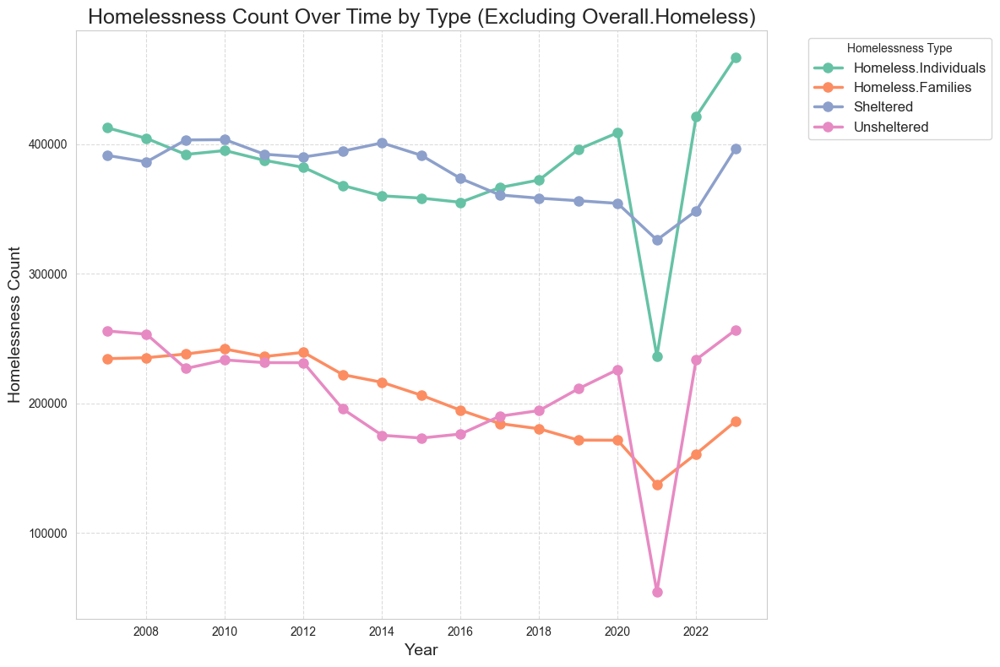

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap

file_path = '/Users/samritha/Downloads/final_homeless_dataset.csv' 
data = pd.read_csv(file_path)

time_series_data = data.groupby(['Year', 'Homelessness.Type'])['Count'].sum().unstack()

filtered_time_series_data = time_series_data.drop(columns=['Overall.Homeless'])

rename_columns = {
    'Sheltered.Total.Homeless': 'Sheltered',
    'Unsheltered.Homeless': 'Unsheltered',
    'Overall.Homeless.Individuals': 'Homeless.Individuals',
    'Overall.Homeless.People.in.Families': 'Homeless.Families'
}
filtered_time_series_data = filtered_time_series_data.rename(columns=rename_columns)

plt.figure(figsize=(12, 8))

cmap = get_cmap('Set2')

for idx, column in enumerate(filtered_time_series_data.columns):
    plt.plot(
        filtered_time_series_data.index, 
        filtered_time_series_data[column], 
        marker='o', 
        linewidth=2.5,  
        markersize=8, 
        color=cmap(idx), 
        label=column
    )

plt.title('Homelessness Count Over Time by Type (Excluding Overall.Homeless)', fontsize=18)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Homelessness Count', fontsize=14)

plt.legend(title='Homelessness Type', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

### Team member - Kunshu Yang

In [ ]:
import pandas as pd
import json

# Read the CSV file
df = pd.read_csv(r'C:\Users\ykks\Desktop\zuoye\spark\final_dataset.csv') 

# Group the data by CoC Name, Year, and Homelessness Type
grouped = df.groupby(['CoC Name', 'Year', 'Homelessness.Type'])['Count'].sum().unstack(level='Homelessness.Type').reset_index()

# Rename columns to match the expected format
grouped = grouped.rename(columns={
    'Overall.Homeless': 'Overall_Homeless',
    'Sheltered.Total.Homeless': 'Sheltered',
    'Unsheltered.Homeless': 'Unsheltered'
})

# Fill NaN values with 0
grouped = grouped.fillna(0)

# Convert data to the required format
data = grouped.to_dict('records')

# Create JavaScript code string
js_data = f"var data = {json.dumps(data)};"

# Read HTML template
with open('templates/index.html', 'r', encoding='utf-8') as file:
    html_template = file.read()

# Insert data into HTML template
html_with_data = html_template.replace('// INSERT_DATA_HERE', js_data)

# Write the result to a new HTML file
output_path = r'C:\Users\ykks\Desktop\zuoye\spark\project\ds-ciss-predictive-homlessness\Demo1\homeless_data_visualization.html'
with open(output_path, 'w', encoding='utf-8') as file:
    file.write(html_with_data)

print(f"HTML file has been generated: {output_path}")

# Verify the data was inserted into the HTML
print("Data insertion verification:")
print("Data variable definition found:" if "var data = " in html_with_data else "Data variable definition NOT found")
print("First data item found:" if str(data[0]) in html_with_data else "First data item NOT found")

# Print the first few items of the processed data
print("\nProcessed data sample:")
print(json.dumps(data[:5], indent=2))

# Data Merging 
# Housing Inventory Count Data from 2007 - 2023

### Team member - Syeda Aqeel

####  Objective
This file aims to present the shelter and permanent housing capacity data, specifically focusing on the "Total Year Round" beds for various housing types: Emergency Shelter (ES), Transitional Housing (TH), Safe Haven (SH), Rapid Re-Housing (RRH), and Permanent Supportive Housing (PSH). The data includes separate indicators for each bed type, distinguishing between Households with Children and Households without Children, at the Continuum of Care (CoC) level. The analysis combines datasets from the 2007-2023 Housing Inventory Count (HIC) provided by the U.S. Department of Housing and Urban Development (HUD) to create a new, comprehensive dataset featuring the required indicators. The source data can be accessed from the "2007-2023-HIC Counts by CoC" Excel file available online.
https://www.hudexchange.info/resource/3031/pit-and-hic-data-since-2007/

In [27]:
import pandas as pd
dfs = pd.read_excel('/Users/samritha/Downloads/2007-2023-HIC-Counts-by-CoC.xlsx', skiprows=1, sheet_name=None)
rename_columns = {
    'CoC': 'CoC Number',
    'Total Year-Round ES Beds': 'Total Year-Round Beds (ES)',
    'Total ES Beds for Households with Children': 'Total Beds for Households with Children (ES)',
    'Total ES Beds for Households without Children': 'Total Beds for Households without Children (ES)',
    'Total Year-Round TH Beds' : 'Total Year-Round Beds (TH)',
    'Total TH Beds for Households with Children' : 'Total Beds for Households with Children (TH)',
    'Total TH Beds for Households without Children' : 'Total Beds for Households without Children (TH)',
    'Total Year-Round SH Beds' : ' Total Year-Round Beds (SH)',
    'Total Year-Round SH Beds without Children' : 'Total Beds for Households without Children (SH)',
    'Total Year-Round RRH Beds' : 'Total Year-Round Beds (RRH)',
    'Total RRH Beds for Households with Children' : 'Total Beds for Households with Children (RRH)',
    'Total RRH Beds for Households without Children' : 'Total Beds for Households without Children (RRH)',
    'Total Year-Round Beds (PSH)' : 'Total Year-Round PSH Beds',
    'Total PSH Beds for Households with Children' : 'Total Beds for Households with Children (PSH)',
    'Total PSH Beds for Households without Children' : 'Total Beds for Households without Children (PSH)'
}

for sheet_name, df in dfs.items():
    dfs[sheet_name] = df.rename(columns=rename_columns)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12

In [28]:
columns_to_extract = [
    'CoC Number',
    'Total Year-Round Beds (ES, TH, SH)',
    'Total Beds for Households with Children (ES, TH, SH)',
    'Total Beds for Households without Children (ES, TH, SH)',
    'Total Year-Round Beds (ES)',
    'Total Beds for Households with Children (ES)',
    'Total Beds for Households without Children (ES)',
    'Total Year-Round Beds (TH)',
    'Total Beds for Households with Children (TH)',
    'Total Beds for Households without Children (TH)',
    'Total Year-Round Beds (SH)',
    'Total Beds for Households with Children (SH)',
    'Total Beds for Households without Children (SH)',
    'Total Year-Round Beds (RRH)',
    'Total Beds for Households with Children (RRH)',
    'Total Beds for Households without Children (RRH)',
    'Total Year-Round PSH Beds',
    'Total Beds for Households with Children (PSH)',
    'Total Beds for Households without Children (PSH)'
]

In [29]:
df_2023 = dfs['2023']
df_2023.head(2)

,CoC Number,"Total Year-Round Beds (ES, TH, SH)","Total Non-DV Year-Round Beds (ES, TH, SH)","Total HMIS Year-Round Beds (ES, TH, SH)","HMIS Participation Rate for Year-Round Beds (ES, TH, SH)",Total Year-Round Beds (ES),Total Year-Round Beds (TH),Total Year-Round Beds (SH),"Total Units for Households with Children (ES, TH, SH)","Total Beds for Households with Children (ES, TH, SH)",...,Total Year-Round Beds (OPH),Total Non-DV Year-Round Beds (OPH),Total HMIS Year-Round Beds (OPH),HMIS Participation Rate for Year-Round Beds (OPH),Total Units for Households with Children (OPH),Total Beds for Households with Children (OPH),Total Beds for Households without Children (OPH),Total Beds for Households with only Children (OPH),Dedicated Veteran Beds (OPH),Dedicated Youth Beds (OPH)
0,AK-500,1188,1110,947,0.7971,950,238,0,107,346,...,226,226,129,0.5708,19,84,142,0,0,0
1,AK-501,1120,659,620,0.5536,847,273,0,119,372,...,142,97,0,0.0000,19,68,74,0,0,0


In [30]:
print(df_2023.columns.tolist())

['CoC Number', 'Total Year-Round Beds (ES, TH, SH)', 'Total Non-DV Year-Round Beds (ES, TH, SH)', 'Total HMIS Year-Round Beds (ES, TH, SH)', 'HMIS Participation Rate for Year-Round Beds (ES, TH, SH)', 'Total Year-Round Beds (ES)', 'Total Year-Round Beds (TH)', 'Total Year-Round Beds (SH)', 'Total Units for Households with Children (ES, TH, SH)', 'Total Beds for Households with Children (ES, TH, SH)', 'Total Beds for Households without Children (ES, TH, SH)', 'Total Beds for Households with only Children (ES, TH, SH)', 'Dedicated Veteran Beds (ES, TH, SH)', 'Dedicated Youth Beds (ES, TH, SH)', 'Total Year-Round Beds (ES).1', 'Total Non-DV Year-Round Beds (ES)', 'Total HMIS Year-Round Beds (ES)', 'HMIS Participation Rate for Year-Round Beds (ES)', 'Total Seasonal Beds (ES)', 'Total Overflow Beds (ES)', 'Total Units for Households with Children (ES)', 'Total Beds for Households with Children (ES)', 'Total Beds for Households without Children (ES)', 'Total Beds for Households with only Chi

In [31]:
df_subset = df_2023.loc[:, columns_to_extract]
df_subset.head()

,CoC Number,"Total Year-Round Beds (ES, TH, SH)","Total Beds for Households with Children (ES, TH, SH)","Total Beds for Households without Children (ES, TH, SH)",Total Year-Round Beds (ES),Total Beds for Households with Children (ES),Total Beds for Households without Children (ES),Total Year-Round Beds (TH),Total Beds for Households with Children (TH),Total Beds for Households without Children (TH),Total Year-Round Beds (SH),Total Beds for Households with Children (SH),Total Beds for Households without Children (SH),Total Year-Round Beds (RRH),Total Beds for Households with Children (RRH),Total Beds for Households without Children (RRH),Total Year-Round PSH Beds,Total Beds for Households with Children (PSH),Total Beds for Households without Children (PSH)
0,AK-500,1188,346,833,950,194,748,238,152,85,0,0,0,256,168,88,720,172,548
1,AK-501,1120,372,718,847,267,551,273,105,167,0,0,0,105,52,53,385,50,335
2,AL-500,544,89,448,424,67,350,110,22,88,10,0,10,179,56,123,1399,239,1160
3,AL-501,394,218,176,252,137,115,142,81,61,0,0,0,173,132,41,241,26,215
4,AL-502,302,121,165,86,51,35,216,70,130,0,0,0,0,0,0,0,0,0


In [32]:
sheet_data = []
for sheet, df in dfs.items():
    selected_columns = df.columns.intersection(columns_to_extract)
    if not selected_columns.empty:
        df_subset = df.loc[:, selected_columns]
        df_subset['Year'] = sheet
        sheet_data.append(df_subset)

In [33]:
merged_data = pd.concat(sheet_data, ignore_index=True)
merged_data.head()

,CoC Number,"Total Year-Round Beds (ES, TH, SH)",Total Year-Round Beds (ES),Total Year-Round Beds (TH),Total Year-Round Beds (SH),"Total Beds for Households with Children (ES, TH, SH)","Total Beds for Households without Children (ES, TH, SH)",Total Beds for Households with Children (ES),Total Beds for Households without Children (ES),Total Beds for Households with Children (TH),Total Beds for Households without Children (TH),Total Beds for Households with Children (SH),Total Beds for Households without Children (SH),Total Year-Round Beds (RRH),Total Beds for Households with Children (RRH),Total Beds for Households without Children (RRH),Total Year-Round PSH Beds,Total Beds for Households with Children (PSH),Total Beds for Households without Children (PSH),Year
0,AK-500,1188.0,950.0,238.0,0.0,346.0,833.0,194.0,748.0,152,85,0.0,0.0,256.0,168.0,88.0,720.0,172.0,548.0,2023
1,AK-501,1120.0,847.0,273.0,0.0,372.0,718.0,267.0,551.0,105,167,0.0,0.0,105.0,52.0,53.0,385.0,50.0,335.0,2023
2,AL-500,544.0,424.0,110.0,10.0,89.0,448.0,67.0,350.0,22,88,0.0,10.0,179.0,56.0,123.0,1399.0,239.0,1160.0,2023
3,AL-501,394.0,252.0,142.0,0.0,218.0,176.0,137.0,115.0,81,61,0.0,0.0,173.0,132.0,41.0,241.0,26.0,215.0,2023
4,AL-502,302.0,86.0,216.0,0.0,121.0,165.0,51.0,35.0,70,130,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2023


In [34]:
merged_data[merged_data['Year'] == '2007']

,CoC Number,"Total Year-Round Beds (ES, TH, SH)",Total Year-Round Beds (ES),Total Year-Round Beds (TH),Total Year-Round Beds (SH),"Total Beds for Households with Children (ES, TH, SH)","Total Beds for Households without Children (ES, TH, SH)",Total Beds for Households with Children (ES),Total Beds for Households without Children (ES),Total Beds for Households with Children (TH),Total Beds for Households without Children (TH),Total Beds for Households with Children (SH),Total Beds for Households without Children (SH),Total Year-Round Beds (RRH),Total Beds for Households with Children (RRH),Total Beds for Households without Children (RRH),Total Year-Round PSH Beds,Total Beds for Households with Children (PSH),Total Beds for Households without Children (PSH),Year
6604,AK-500,NaN,500.0,384.0,NaN,NaN,NaN,134.0,366.0,121,263,NaN,NaN,NaN,NaN,NaN,330.0,53.0,277.0,2007
6605,AK-501,NaN,595.0,279.0,NaN,NaN,NaN,304.0,291.0,113,166,NaN,NaN,NaN,NaN,NaN,159.0,20.0,139.0,2007
6606,AL-500,NaN,388.0,915.0,NaN,NaN,NaN,80.0,308.0,431,484,NaN,NaN,NaN,NaN,NaN,1292.0,817.0,475.0,2007
6607,AL-501,NaN,133.0,326.0,NaN,NaN,NaN,62.0,71.0,127,199,NaN,NaN,NaN,NaN,NaN,171.0,49.0,122.0,2007
6608,AL-502,NaN,36.0,138.0,NaN,NaN,NaN,22.0,14.0,53,85,NaN,NaN,NaN,NaN,NaN,79.0,0.0,79.0,2007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7061,WV-501,NaN,218.0,163.0,NaN,NaN,NaN,95.0,123.0,76,87,NaN,NaN,NaN,NaN,NaN,280.0,38.0,242.0,2007
7062,WV-503,NaN,295.0,121.0,NaN,NaN,NaN,98.0,197.0,47,74,NaN,NaN,NaN,NaN,NaN,61.0,0.0,61.0,2007
7063,WV-508,NaN,638.0,331.0,NaN,NaN,NaN,119.0,519.0,133,198,NaN,NaN,NaN,NaN,NaN,113.0,34.0,79.0,2007
7064,WY-500,NaN,504.0,225.0,NaN,NaN,NaN,218.0,286.0,97,128,NaN,NaN,NaN,NaN,NaN,67.0,0.0,67.0,2007


In [35]:
merged_data.shape

(7066, 20)

In [36]:
# Merged dataset for indicators under consideration from 2007 to 2023 for HIC data set. 
merged_data.to_csv('2007-2023-HIC-Counts-by-CoC_merged.csv')

# Point In Time Count Data 
### Feature Engineering 



### Team members - Renjie Fan & Kunshu Yang

In [ ]:
import pandas as pd
import numpy as np

df_table3 = pd.read_csv(r'C:\Users\ykks\Desktop\zuoye\spark\10.20\ACS_Data\merged_final_data_cleaned.csv')
df_table4 = pd.read_csv(r'C:\Users\ykks\Desktop\zuoye\spark\10.20\data2\poverty_cost_burden_rates_cleaned.csv')

df_table3['year'] = df_table3['year'].astype(float)
df_table4['year'] = df_table4['year'].astype(float)

df_merged = pd.merge(
    df_table3,
    df_table4[['geo_id', 'year', 'CoC_Number', 'poverty_rate', 'cost_burden_rate']],
    on=['geo_id', 'year', 'CoC_Number'],
    how='left'
)

cols = list(df_table3.columns) 

# unemployment_rate & rental_vacancy_rate
rate_pos = cols.index('rental_vacancy_rate')
new_cols = cols[:rate_pos+1] + ['poverty_rate', 'cost_burden_rate'] + cols[rate_pos+1:]

df_final = df_merged[new_cols]

output_file = r'C:\Users\ykks\Desktop\zuoye\spark\10.20\ACS_Data\final_merged_data.csv'
df_final.to_csv(output_file, index=False)

print("合并结果统计：")
print(f"总行数: {len(df_final)}")
print("\n各比率的数据完整性：")
print(f"unemployment_rate 非空值数量: {df_final['unemployment_rate'].notna().sum()}")
print(f"rental_vacancy_rate 非空值数量: {df_final['rental_vacancy_rate'].notna().sum()}")
print(f"poverty_rate 非空值数量: {df_final['poverty_rate'].notna().sum()}")
print(f"cost_burden_rate 非空值数量: {df_final['cost_burden_rate'].notna().sum()}")

print("\n合并后的数据示例（前几列）：")
print(df_final[['geo_id', 'year', 'unemployment_rate', 'rental_vacancy_rate', 'poverty_rate', 'cost_burden_rate']].head())

# Merged Weather data with "ACS-PIT-HIC" data

### Team member - Samritha Aadhi Ravikumar

In [37]:
import pandas as pd

# Load ACS data
acs_data = pd.read_csv("/Users/samritha/Downloads/ACS_PIT_HIC.csv", low_memory=False)
print(acs_data.head())
print(acs_data.shape)

# Load weather data (from Excel)
weather_data = pd.read_excel("/Users/samritha/Downloads/Weather.xlsx", sheet_name="Average Temperature", header=1)
print(weather_data.head())
print(weather_data.shape)

  CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
0     AK-500  2007       257633        21379       103203         7663   
1     AK-500  2008       257633        21379       103203         7663   
2     AK-500  2009       257633        21379       103203         7663   
3     AK-500  2010       257633        21379       103203         7663   
4     AK-500  2011       250934        21341       100652         7120   

   B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
0        39036        95540        16455       141362  ...   
1        39036        95540        16455       141362  ...   
2        39036        95540        16455       141362  ...   
3        39036        95540        16455       141362  ...   
4        39558        93532        16949       136321  ...   

   Total Beds for Households with Children (TH)  \
0                                           121   
1                                           131   
2                            

In [38]:
# Remove the column '...1'
acs_data = acs_data.drop(columns=['...1'])

# Check if the column is removed
print(acs_data.columns)

Index(['CoC_Number', 'Year', 'B01003_001E', 'B17001_002E', 'B25002_001E',
       'B25002_003E', 'B25003_003E', 'B25003_001E', 'B25106_001E',
       'B23025_003E', 'B23025_005E', 'B25064_001E', 'B19013_001E',
       'Unemployment_Rate', 'Vacancy_Rate', 'Renter_Household_Rate',
       'Cost_Burdened_Rate', 'Poverty_Rate', 'Overall Homeless',
       'Overall Homeless Individuals', 'Overall Homeless People in Families',
       'Unsheltered Homeless', 'Sheltered Total Homeless',
       'Total Year-Round Beds (ES, TH, SH)', 'Total Year-Round Beds (ES)',
       'Total Year-Round Beds (TH)', 'Total Year-Round Beds (SH)',
       'Total Beds for Households with Children (ES, TH, SH)',
       'Total Beds for Households without Children (ES, TH, SH)',
       'Total Beds for Households with Children (ES)',
       'Total Beds for Households without Children (ES)',
       'Total Beds for Households with Children (TH)',
       'Total Beds for Households without Children (TH)',
       'Total Beds for H

In [39]:
## Mapping State Initials

# State names to initials mapping
state_map = {
    "Alabama": "AL", "Alaska": "AK", "Arizona": "AZ", "Arkansas": "AR", "California": "CA",
    "Colorado": "CO", "Connecticut": "CT", "Delaware": "DE", "Florida": "FL", "Georgia": "GA",
    "Hawaii": "HI", "Idaho": "ID", "Illinois": "IL", "Indiana": "IN", "Iowa": "IA",
    "Kansas": "KS", "Kentucky": "KY", "Louisiana": "LA", "Maine": "ME", "Maryland": "MD",
    "Massachusetts": "MA", "Michigan": "MI", "Minnesota": "MN", "Mississippi": "MS", "Missouri": "MO",
    "Montana": "MT", "Nebraska": "NE", "Nevada": "NV", "New Hampshire": "NH", "New Jersey": "NJ",
    "New Mexico": "NM", "New York": "NY", "North Carolina": "NC", "North Dakota": "ND", "Ohio": "OH",
    "Oklahoma": "OK", "Oregon": "OR", "Pennsylvania": "PA", "Rhode Island": "RI", "South Carolina": "SC",
    "South Dakota": "SD", "Tennessee": "TN", "Texas": "TX", "Utah": "UT", "Vermont": "VT",
    "Virginia": "VA", "Washington": "WA", "West Virginia": "WV", "Wisconsin": "WI", "Wyoming": "WY"
}

# Add state initials to weather data
weather_data['State Initials'] = weather_data['States'].map(state_map)

print(weather_data.head())

       States  2007  2008  2009  2010  2011  2012  2013  2014  2015  2016  \
0     Alabama  46.7  43.0  45.3  40.0  41.1  50.1  50.0  37.3  43.6  43.0   
1      Alaska   5.5   0.4  -0.2   1.5   7.0 -12.8   9.8  18.4   7.1  17.2   
2     Arizona  39.0  39.8  45.2  42.2  41.5  45.3  38.6  46.5  45.1  41.8   
3    Arkansas  39.9  39.0  38.4  36.5  37.6  44.6  42.1  35.2  38.6  39.5   
4  California  41.5  41.1  46.9  45.2  45.2  46.5  42.1  50.1  48.6  44.5   

   2017  2018  2019  2020  2021  2022  2023 State Initials  
0  52.4  40.4  46.5  49.5  46.6  43.9  51.4             AL  
1   4.5   6.7   7.5  -6.4  10.6   2.6  10.9             AK  
2  42.3  47.6  42.4  43.7  42.6  43.5  40.2             AZ  
3  45.2  35.7  40.8  43.9  41.4  38.7  46.4             AR  
4  42.2  48.9  46.1  45.3  45.5  46.2  42.6             CA  


In [40]:
# Ensure column names are strings
weather_data.columns = weather_data.columns.map(str)

# Identify year columns
year_columns = [col for col in weather_data.columns if col.isdigit()]

# Reshape weather data to long format
weather_long = weather_data.melt(
    id_vars=['State Initials'], 
    value_vars=year_columns, 
    var_name='Year', 
    value_name='Average Temperature'
)

# Convert year to integer
weather_long['Year'] = weather_long['Year'].astype(int)

print(weather_long.head())
print(weather_long.shape)

  State Initials  Year  Average Temperature
0             AL  2007                 46.7
1             AK  2007                  5.5
2             AZ  2007                 39.0
3             AR  2007                 39.9
4             CA  2007                 41.5
(833, 3)


In [41]:
## Merging ACS & Weather Datasets

# Extract state initials from CoC_Number in ACS data
acs_data['State Initials'] = acs_data['CoC_Number'].str[:2]

# Ensure the 'Year' column exists and matches the format in both datasets (ACS and Weather)
# If needed, convert the Year columns to integers in ACS as well
acs_data['Year'] = acs_data['Year'].astype(int)

# Merge the datasets on State Initials and Year
merged_data = pd.merge(
    acs_data, 
    weather_long[['State Initials', 'Year', 'Average Temperature']],  # Select relevant columns from weather data
    on=['State Initials', 'Year'],  # Merge on State Initials and Year
    how='left'  # Left join to keep all ACS data
)

# Preview merged data
print(acs_data['Year'].unique()) 
print(merged_data.head())
print(merged_data.shape)

[2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020
 2021 2022 2023]
  CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
0     AK-500  2007       257633        21379       103203         7663   
1     AK-500  2008       257633        21379       103203         7663   
2     AK-500  2009       257633        21379       103203         7663   
3     AK-500  2010       257633        21379       103203         7663   
4     AK-500  2011       250934        21341       100652         7120   

   B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
0        39036        95540        16455       141362  ...   
1        39036        95540        16455       141362  ...   
2        39036        95540        16455       141362  ...   
3        39036        95540        16455       141362  ...   
4        39558        93532        16949       136321  ...   

   Total Beds for Households with Children (SH)  \
0                                          

#### Data Cleaning for Merged Dataset

In [42]:
# Check for missing values
print(merged_data.isnull().sum())

CoC_Number                                                   34
Year                                                          0
B01003_001E                                                   0
B17001_002E                                                   0
B25002_001E                                                   0
B25002_003E                                                   0
B25003_003E                                                   0
B25003_001E                                                   0
B25106_001E                                                   0
B23025_003E                                                   0
B23025_005E                                                   0
B25064_001E                                                   0
B19013_001E                                                   0
Unemployment_Rate                                             0
Vacancy_Rate                                                  0
Renter_Household_Rate                   

In [43]:
# Find rows where 'avg_temp' is NaN
nan_rows_1 = merged_data[merged_data['Average Temperature'].isna()]

# Display the rows with NaN in 'avg_temp'
print(nan_rows_1)

     CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
1118     DC-500  2007       547151        99776       280088        35136   
1119     DC-500  2008       547151        99776       280088        35136   
1120     DC-500  2009       547151        99776       280088        35136   
1121     DC-500  2010       547151        99776       280088        35136   
1122     DC-500  2011       559475        99187       283668        34110   
...         ...   ...          ...          ...          ...          ...   
5516     SD-500  2019       824875       108687       373613        46289   
5517     SD-500  2020       805956       104051       365221        46659   
5518     SD-500  2021       802421       100839       357845        43862   
5519     SD-500  2022       782841        96732       351136        41864   
5520     SD-500  2023       782841        96732       351136        41864   

      B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
1118      

In [44]:
# Create a mapping of year to avg_temp for Washington (WA)
wa_temp_mapping = weather_long[weather_long['State Initials'] == 'WA'][['Year', 'Average Temperature']]

# Rename the columns to match 'merged_data'
wa_temp_mapping.rename(columns={'Year': 'Year', 'Average Temperature': 'Average Temperature_wa'}, inplace=True)

# Merge this mapping with merged_data based on 'Year of data' to get Washington's avg_temp for each year
merged_data = merged_data.merge(wa_temp_mapping, on='Year', how='left')

# Use .map() to assign the Washington avg_temp to DC based on the 'Year of data'
merged_data.loc[merged_data['State Initials'] == 'DC', 'Average Temperature'] = merged_data.loc[merged_data['State Initials'] == 'DC', 'Year'].map(wa_temp_mapping.set_index('Year')['Average Temperature_wa'])

# Drop the temporary 'Average Temperature_wa' column
merged_data.drop(columns=['Average Temperature_wa'], inplace=True)

# Check the updated rows for DC
print(merged_data[merged_data['State Initials'] == 'DC'].head())

     CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
1118     DC-500  2007       547151        99776       280088        35136   
1119     DC-500  2008       547151        99776       280088        35136   
1120     DC-500  2009       547151        99776       280088        35136   
1121     DC-500  2010       547151        99776       280088        35136   
1122     DC-500  2011       559475        99187       283668        34110   

      B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
1118       140868       244952        65393       317844  ...   
1119       140868       244952        65393       317844  ...   
1120       140868       244952        65393       317844  ...   
1121       140868       244952        65393       317844  ...   
1122       144339       249558        67221       319690  ...   

      Total Beds for Households with Children (SH)  \
1118                                           NaN   
1119                                  

In [45]:
# Temperature values for South Dakota (SD) from 2007 to 2023
sd_temps = [20.1, 16.2, 16.7, 14.8, 13, 25.4, 19.4, 18.3, 22.7, 19.8, 16.5, 18.1, 18, 20.1, 26.5, 19.1, 20]

# Create a mapping of year to avg_temp for South Dakota (SD) from 2007 to 2023
sd_temp_mapping = pd.DataFrame({
    'Year': range(2007, 2007 + len(sd_temps)),  # Adjust the years to match the length of sd_temps
    'Average Temperature': sd_temps
})

# Assuming merged_data is your main dataset
# Extract geo_ids where the state initials are 'SD' (South Dakota)
sd_geo_ids = merged_data[merged_data['State Initials'] == 'SD']

# Merge this mapping with merged_data based on 'Year of data' to get SD's avg_temp for each year
merged_data = merged_data.merge(sd_temp_mapping, on='Year', how='left', suffixes=('', '_sd'))

# Update the 'Average Temperature' column with 'Average Temperature_sd' for rows with state_initials 'SD'
merged_data.loc[merged_data['State Initials'] == 'SD', 'Average Temperature'] = merged_data.loc[merged_data['State Initials'] == 'SD', 'Average Temperature_sd']

# Drop the temporary 'Average Temperature_sd' column
merged_data.drop(columns=['Average Temperature_sd'], inplace=True)

# Display the updated rows for SD (with State Initials 'SD')
print(merged_data[merged_data['State Initials'] == 'SD'].head())

     CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
5504     SD-500  2007       729908        96232       331562        40574   
5505     SD-500  2008       729908        96232       331562        40574   
5506     SD-500  2009       729908        96232       331562        40574   
5507     SD-500  2010       729908        96232       331562        40574   
5508     SD-500  2011       749866        98077       339315        40947   

      B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
5504        92333       290988        32714       398408  ...   
5505        92333       290988        32714       398408  ...   
5506        92333       290988        32714       398408  ...   
5507        92333       290988        32714       398408  ...   
5508        94671       298368        33822       405410  ...   

      Total Beds for Households with Children (SH)  \
5504                                           NaN   
5505                                  

In [46]:
# Check for missing values
print(merged_data.isnull().sum())

CoC_Number                                                   34
Year                                                          0
B01003_001E                                                   0
B17001_002E                                                   0
B25002_001E                                                   0
B25002_003E                                                   0
B25003_003E                                                   0
B25003_001E                                                   0
B25106_001E                                                   0
B23025_003E                                                   0
B23025_005E                                                   0
B25064_001E                                                   0
B19013_001E                                                   0
Unemployment_Rate                                             0
Vacancy_Rate                                                  0
Renter_Household_Rate                   

In [47]:
# Filter the dataset for rows related to Hawaii using the State Initials column
hawaii_rows = merged_data[merged_data['State Initials'] == 'HI']

# Display the number of rows for Hawaii
num_rows_hi = hawaii_rows.shape[0]

print(f"Number of rows for Hawaii: {num_rows_hi}")

Number of rows for Hawaii: 34


In [48]:
# Find rows where 'state_initials' is NaN
nan_rows_2 = merged_data[merged_data['State Initials'].isna()]

# Display the rows with NaN in 'avg_temp'
print(nan_rows_2)

     CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
6490        NaN  2007       914042       151454       442200        92361   
6491        NaN  2007       914042       151454       442200        92361   
6492        NaN  2008       914042       151454       442200        92361   
6493        NaN  2008       914042       151454       442200        92361   
6494        NaN  2009       914042       151454       442200        92361   
6495        NaN  2009       914042       151454       442200        92361   
6496        NaN  2010       914042       151454       442200        92361   
6497        NaN  2010       914042       151454       442200        92361   
6498        NaN  2011       919135       156918       445039        94408   
6499        NaN  2011       919135       156918       445039        94408   
6500        NaN  2012       899200       158875       434498        92841   
6501        NaN  2012       899200       158875       434498        92841   

In [49]:
# Filter the dataset for rows related to Puerto Rico using the 'CoC_Number' prefix 'PR', excluding NaN values
puerto_rico_rows = merged_data[merged_data['CoC_Number'].notna() & merged_data['CoC_Number'].str.startswith('PR')]

# Display the number of rows for Puerto Rico
num_rows_pr = puerto_rico_rows.shape[0]

print(f"Number of rows for Puerto Rico: {num_rows_pr}")

Number of rows for Puerto Rico: 34


In [50]:
# Fill NaN values in 'CoC_Number' with an empty string or another placeholder
merged_data['CoC_Number'] = merged_data['CoC_Number'].fillna('')

# Replace 'Average Temperature' with NaN for rows where 'CoC_Number' starts with 'PR'
merged_data.loc[merged_data['CoC_Number'].str.startswith('PR'), 'Average Temperature'] = float('nan')

# Verify by printing a few rows with 'CoC_Number' starting with 'PR'
print(merged_data[merged_data['CoC_Number'].str.startswith('PR')].head())

     CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
5385     PR-502  2007      1661347       670696       655473        99436   
5386     PR-502  2008      1661347       670696       655473        99436   
5387     PR-502  2009      1661347       670696       655473        99436   
5388     PR-502  2010      1661347       670696       655473        99436   
5389     PR-502  2011      1656701       676903       667891       109552   

      B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
5385       162079       556037        57186       637767  ...   
5386       162079       556037        57186       637767  ...   
5387       162079       556037        57186       637767  ...   
5388       162079       556037        57186       637767  ...   
5389       167399       558339        58725       639944  ...   

      Total Beds for Households with Children (SH)  \
5385                                           NaN   
5386                                  

In [51]:
# Check for missing values
print(merged_data.isnull().sum())

CoC_Number                                                    0
Year                                                          0
B01003_001E                                                   0
B17001_002E                                                   0
B25002_001E                                                   0
B25002_003E                                                   0
B25003_003E                                                   0
B25003_001E                                                   0
B25106_001E                                                   0
B23025_003E                                                   0
B23025_005E                                                   0
B25064_001E                                                   0
B19013_001E                                                   0
Unemployment_Rate                                             0
Vacancy_Rate                                                  0
Renter_Household_Rate                   

In [52]:
import numpy as np

# Find the rows where 'CoC_Number' starts with 'PR'
coc_number_pr_rows = merged_data[merged_data['CoC_Number'].str.startswith('PR')]

# Find the rows where 'State Initials' is missing
missing_state_initials_rows = merged_data[merged_data['State Initials'].isna()]

# Subtract the rows that start with 'PR' from the rows with missing 'State Initials'
remaining_missing_rows = missing_state_initials_rows[~missing_state_initials_rows.index.isin(coc_number_pr_rows.index)]

# Display the remaining rows
print(remaining_missing_rows)

# List of indices for the remaining rows where 'State Initials' is missing and 'CoC_Number' doesn't start with 'PR'
remaining_missing_indices = remaining_missing_rows.index

# Replace the 'Average Temperature' with NaN for these rows
merged_data.loc[remaining_missing_indices, 'Average Temperature'] = np.nan

# Verify the change
print(merged_data.loc[remaining_missing_indices, ['Average Temperature']])

     CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
6490             2007       914042       151454       442200        92361   
6491             2007       914042       151454       442200        92361   
6492             2008       914042       151454       442200        92361   
6493             2008       914042       151454       442200        92361   
6494             2009       914042       151454       442200        92361   
6495             2009       914042       151454       442200        92361   
6496             2010       914042       151454       442200        92361   
6497             2010       914042       151454       442200        92361   
6498             2011       919135       156918       445039        94408   
6499             2011       919135       156918       445039        94408   
6500             2012       899200       158875       434498        92841   
6501             2012       899200       158875       434498        92841   

In [53]:
# Check for missing values
print(merged_data.isnull().sum())

CoC_Number                                                    0
Year                                                          0
B01003_001E                                                   0
B17001_002E                                                   0
B25002_001E                                                   0
B25002_003E                                                   0
B25003_003E                                                   0
B25003_001E                                                   0
B25106_001E                                                   0
B23025_003E                                                   0
B23025_005E                                                   0
B25064_001E                                                   0
B19013_001E                                                   0
Unemployment_Rate                                             0
Vacancy_Rate                                                  0
Renter_Household_Rate                   

In [54]:
# Save the modified dataset to a CSV file
merged_data.to_csv("/Users/samritha/Downloads/Merged_Data.csv", index=False)

# Verify the changes
print(merged_data.head())
print(merged_data.shape)

  CoC_Number  Year  B01003_001E  B17001_002E  B25002_001E  B25002_003E  \
0     AK-500  2007       257633        21379       103203         7663   
1     AK-500  2008       257633        21379       103203         7663   
2     AK-500  2009       257633        21379       103203         7663   
3     AK-500  2010       257633        21379       103203         7663   
4     AK-500  2011       250934        21341       100652         7120   

   B25003_003E  B25003_001E  B25106_001E  B23025_003E  ...  \
0        39036        95540        16455       141362  ...   
1        39036        95540        16455       141362  ...   
2        39036        95540        16455       141362  ...   
3        39036        95540        16455       141362  ...   
4        39558        93532        16949       136321  ...   

   Total Beds for Households with Children (SH)  \
0                                           NaN   
1                                           NaN   
2                            

### Merging Process Summary

##### 1. Loading the ACS and Weather Datasets
#####      ACS Dataset - (6524, 42); Removed the column '...1'
#####      Weather Dataset - (49, 18)

##### 2. Mapping State Initials
#####      Only 50 states of U.S (Union Territory not included)

##### 3. Merging Weather data to ACS data (as a variables in ACS dataset)

##### 4. Data Cleaning 
#####      Updated Washington's "Average Temperature" to District of Columbia (D.C)
#####      Hawaii's "Average Temperature" is missing - 34 rows
#####      South Dakota's weather is swapped with Puerto Rico's weather; Puerto Rico's "State Initials" is missing
#####      South Dakota's "Average Temperature" is updated from weather data
#####      Puerto Rico's "Average Temperature" is replaced by NaN values - 34 rows
#####      Additionally, 34 Rows were missing with almost every values; Replaced "Average Temperature" is replaced by NaN values

##### 5. Saving final Merged Dataset (6524, 43)
#####      Data loss - 0 rows      
#####      Average Temperature (Hawaii + Puerto Rico + 34 Unknown) - 102 rows  
#####      State Initials (34 Unknown) - 34 rows 


# Feature Engineering - Target Variables calculated as per capita 

### Team member - Kunshu Yang

In [ ]:
import pandas as pd

df = pd.read_csv(r"C:\Users\ykks\Desktop\zuoye\spark\model\Final_estimate.csv")

# 假设原始数据中有以下列名，请根据您的实际数据列名进行修改：
# "Total Population", "Overall Homeless", "Overall Homeless Individuals", 
# "Overall Homeless People in Families", "Unsheltered Homeless", "Sheltered Total Homeless"

# 计算人均无家可归相关指标
df["Overall_Homeless_Per_Capita"] = df["Overall Homeless"] / df["Total Population"]
df["Overall_Homeless_Individuals_Per_Capita"] = df["Overall Homeless Individuals"] / df["Total Population"]
df["Overall_Homeless_People_in_Families_Per_Capita"] = df["Overall Homeless People in Families"] / df["Total Population"]
df["Unsheltered_Homeless_Per_Capita"] = df["Unsheltered Homeless"] / df["Total Population"]
df["Sheltered_Homeless_Per_Capita"] = df["Sheltered Total Homeless"] / df["Total Population"]

# 如有需要，可将结果保存为新的CSV文件
df.to_csv(r"C:\Users\ykks\Desktop\zuoye\spark\model\Final_estimate_per_capita.csv", index=False)

print("人均无家可归数据已成功计算并保存！")

# Data Modeling

### Team member - Samritha Aadhi Ravikumar - HistGradientBoostRegressor

In [55]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.experimental import enable_hist_gradient_boosting  
from sklearn.ensemble import HistGradientBoostingRegressor  
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

# Load the dataset
file_path = '/Users/samritha/Downloads/Final_Dataset.csv'  
data = pd.read_csv(file_path)
data.head()

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/experimental/enable_hist_gradient_boosting.py:16: UserWarning:

Since version 1.0, it is not needed to import enable_hist_gradient_boosting anymore. HistGradientBoostingClassifier and HistGradientBoostingRegressor are now stable and can be normally imported from sklearn.ensemble.



,Total Population,Median Gross Rent,Median Household Income,Poverty_Rate,Vacancy_Rate,Renter_Household_Rate,Cost_Burdened_Rate,Unemployment_Rate,"Total Year-Round Beds (ES, TH, SH)",Average Temperature,Overall Homeless,Overall Homeless Individuals,Overall Homeless People in Families,Unsheltered Homeless,Sheltered Total Homeless,Overall_Homeless_Per_Capita,Overall_Homeless_Individuals_Per_Capita,Overall_Homeless_People_in_Families_Per_Capita,Unsheltered_Homeless_Per_Capita,Sheltered_Homeless_Per_Capita
0,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,5.5,974.0,696.0,278.0,132.0,842.0,0.003781,0.002702,0.001079,0.000512,0.003268
1,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,0.4,1023.0,695.0,328.0,102.0,921.0,0.003971,0.002698,0.001273,0.000396,0.003575
2,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,-0.2,1267.0,821.0,446.0,157.0,1110.0,0.004918,0.003187,0.001731,0.000609,0.004308
3,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,1.5,1231.0,740.0,491.0,118.0,1113.0,0.004778,0.002872,0.001906,0.000458,0.004320
4,250934,54926,3573107,8.504627,7.073878,42.293547,42.845948,7.593841,NaN,7.0,1223.0,794.0,429.0,141.0,1082.0,0.004874,0.003164,0.001710,0.000562,0.004312


In [56]:
# View column names and data types
column_names = data.columns.tolist()  
column_types = data.dtypes.tolist()  
columns_table = pd.DataFrame({"Column Names": column_names, "Data Types": column_types})  
print(columns_table)  

                                      Column Names Data Types
0                                 Total Population      int64
1                                Median Gross Rent      int64
2                          Median Household Income      int64
3                                     Poverty_Rate    float64
4                                     Vacancy_Rate    float64
5                            Renter_Household_Rate    float64
6                               Cost_Burdened_Rate    float64
7                                Unemployment_Rate    float64
8               Total Year-Round Beds (ES, TH, SH)    float64
9                              Average Temperature    float64
10                                Overall Homeless    float64
11                    Overall Homeless Individuals    float64
12             Overall Homeless People in Families    float64
13                            Unsheltered Homeless    float64
14                        Sheltered Total Homeless    float64
15      

In [57]:
# Replace placeholder values (e.g., '.') with NaN and convert data to float64
data.replace('.', float('nan'), inplace=True)
data = data.astype('float64')  

In [58]:
# Define predictors (X) and target variables (y)
# Drop irrelevant columns from X
X = data.drop(columns=[
    'Median Gross Rent', 'Overall Homeless', 'Overall Homeless Individuals',
    'Overall Homeless People in Families', 'Unsheltered Homeless', 'Sheltered Total Homeless',
    'Overall_Homeless_Per_Capita', 'Overall_Homeless_Individuals_Per_Capita',
    'Overall_Homeless_People_in_Families_Per_Capita', 'Unsheltered_Homeless_Per_Capita',
    'Sheltered_Homeless_Per_Capita'
])

# Display the updated columns of predictors
columns_table = pd.DataFrame({'Column Names': X.columns})
print(columns_table)

                         Column Names
0                    Total Population
1             Median Household Income
2                        Poverty_Rate
3                        Vacancy_Rate
4               Renter_Household_Rate
5                  Cost_Burdened_Rate
6                   Unemployment_Rate
7  Total Year-Round Beds (ES, TH, SH)
8                 Average Temperature


In [59]:
# Scale target variables by multiplying them by 1000
y1 = data['Overall_Homeless_Per_Capita'] * 1000
y2 = data['Overall_Homeless_Individuals_Per_Capita'] * 1000
y3 = data['Overall_Homeless_People_in_Families_Per_Capita'] * 1000
y4 = data['Unsheltered_Homeless_Per_Capita'] * 1000
y5 = data['Sheltered_Homeless_Per_Capita'] * 1000

In [60]:
# Handle missing values in the target variables by filling them with 0
y1.fillna(0, inplace=True)
y2.fillna(0, inplace=True)
y3.fillna(0, inplace=True)
y4.fillna(0, inplace=True)
y5.fillna(0, inplace=True)

In [61]:
# Apply log transformation to target variables for normalization
y1 = np.log1p(y1)
y2 = np.log1p(y2)
y3 = np.log1p(y3)
y4 = np.log1p(y4)
y5 = np.log1p(y5)

In [62]:
# Standardize predictor variables (X)
if isinstance(X, pd.DataFrame):  
    scaler = StandardScaler()  
    X_scaled = scaler.fit_transform(X) 
    
    # Convert back to DataFrame to retain column names
    X = pd.DataFrame(X_scaled, columns=X.columns)
    columns_table = pd.DataFrame({'Column Names': X.columns})  

In [63]:
# Define target variables and their names
target_variables = [y1, y2, y3, y4, y5]
target_names = [
    "Overall Homeless",
    "Overall Homeless Individuals",
    "Overall Homeless People in Families",
    "Unsheltered Homeless",
    "Sheltered Homeless"
]

# Initialize an empty list to store results
results = []

# Train and evaluate models for each target variable
for y, name in zip(target_variables, target_names):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Train the HistGradientBoostingRegressor model
    model = HistGradientBoostingRegressor(random_state=42)
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Calculate metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    
    # Append the results to the list
    results.append({
        "Target Variable": name,
        "MSE": round(mse, 2),
        "RMSE": round(rmse, 2),
        "R²": round(r2, 2)
    })
    
# Convert the results list into a pandas DataFrame
results_df = pd.DataFrame(results)

# Display the results as a table
print("Evaluation Metrics (Tabular Results):")
print(results_df)  
    

Evaluation Metrics (Tabular Results):
                       Target Variable   MSE  RMSE    R²
0                     Overall Homeless  0.15  0.38  0.59
1         Overall Homeless Individuals  0.13  0.35  0.60
2  Overall Homeless People in Families  0.10  0.32  0.42
3                 Unsheltered Homeless  0.13  0.37  0.58
4                   Sheltered Homeless  0.11  0.33  0.52


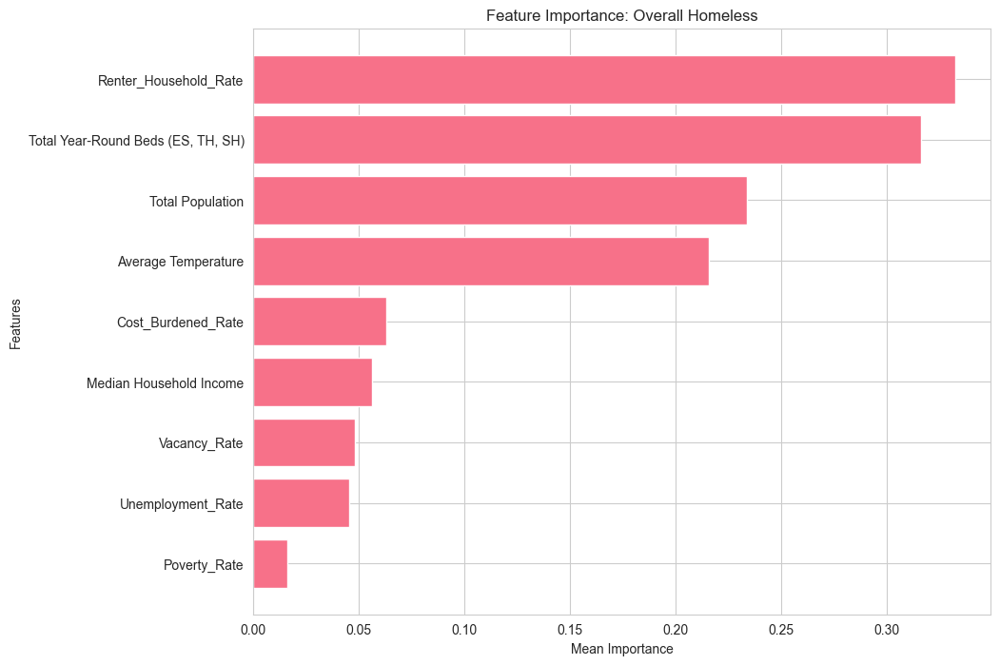

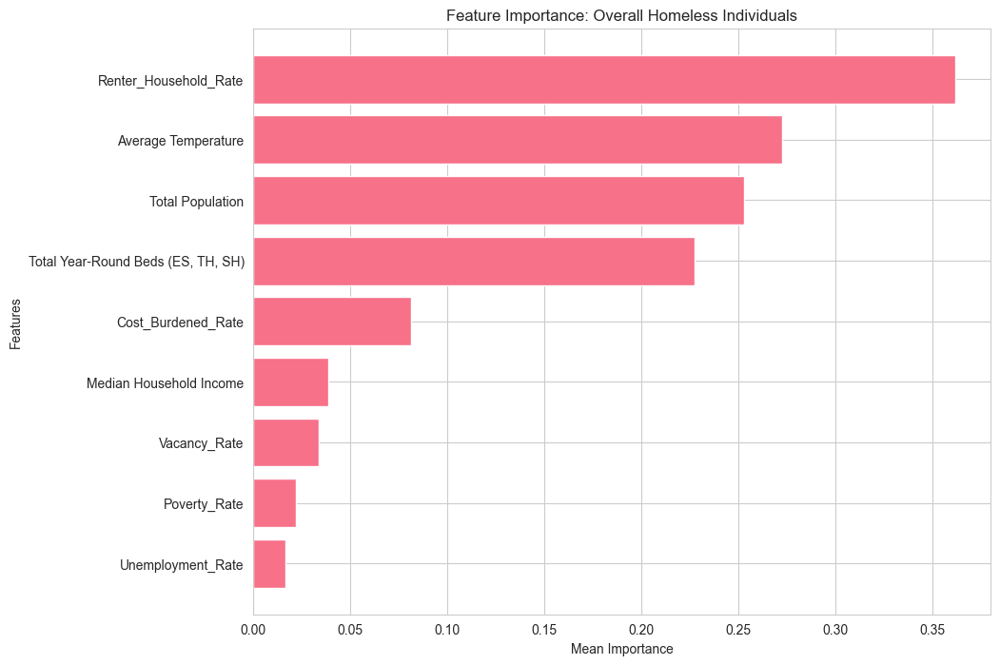

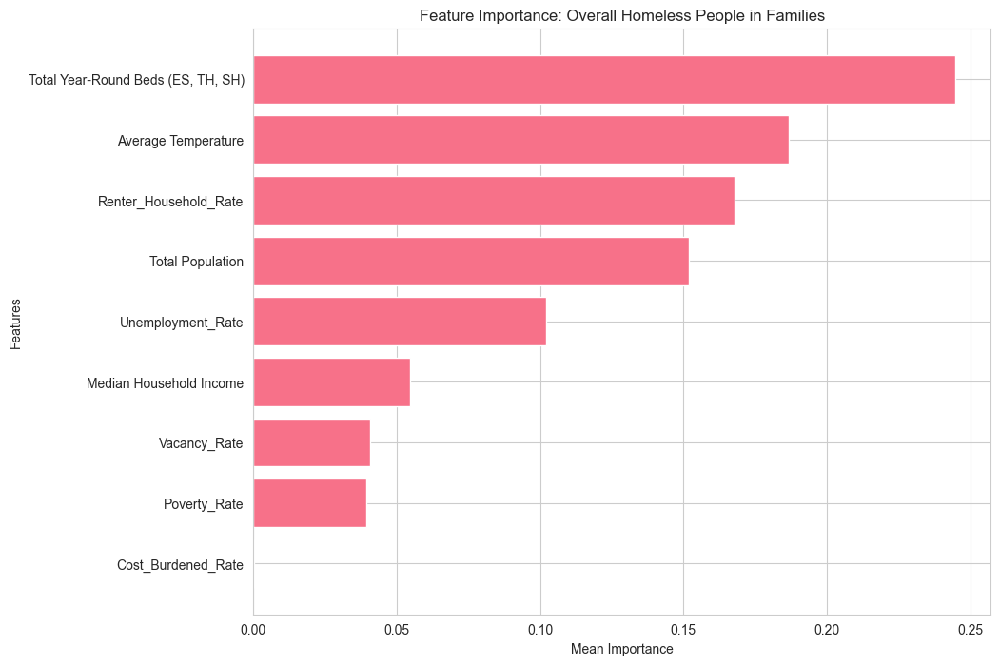

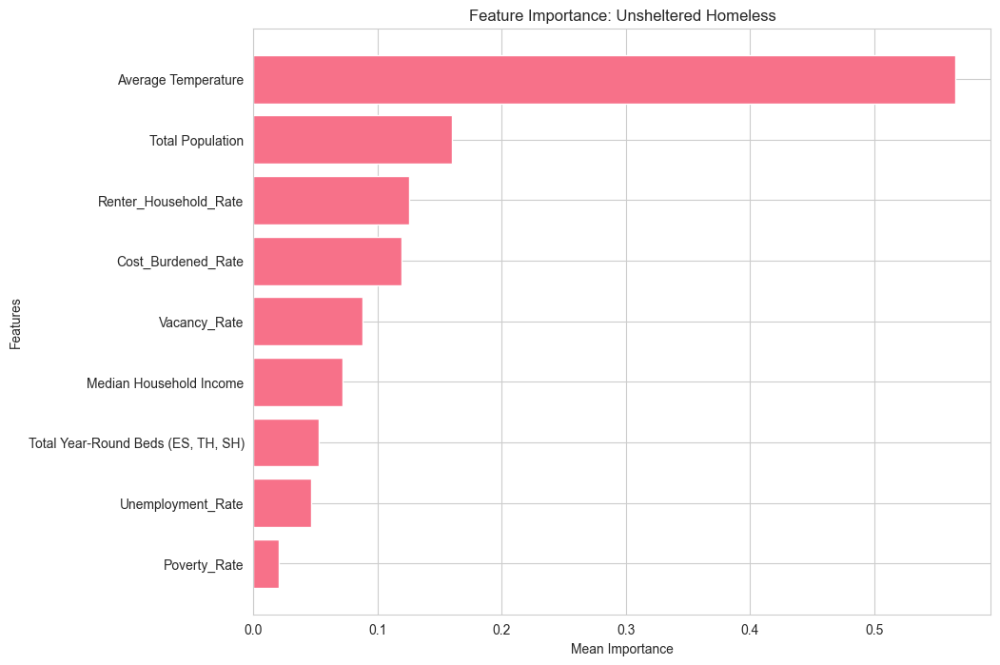

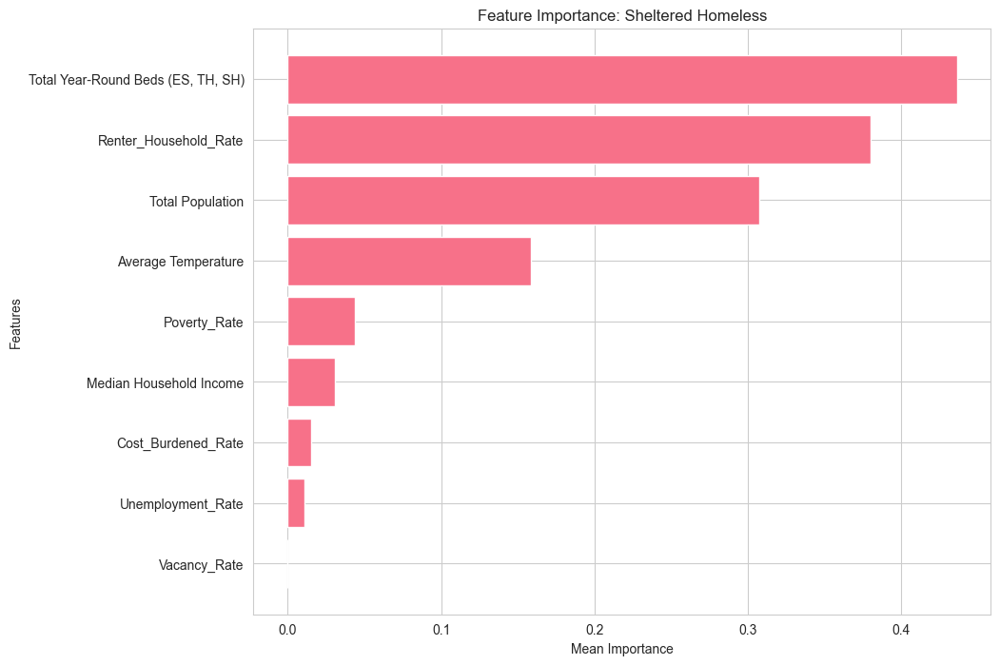

In [64]:
from sklearn.inspection import permutation_importance

# Feature importance analysis using permutation importance and plotting
for y, name in zip(target_variables, target_names):
    # Re-train the model for feature importance plot
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model = HistGradientBoostingRegressor(random_state=42)
    model.fit(X_train, y_train)
    
    # Feature importance analysis using permutation importance
    result = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)

    # Extract sorted indices of features based on importance
    sorted_idx = result.importances_mean.argsort()

    # Plot sorted feature importances
    plt.figure(figsize=(10, 8))
    plt.barh([X.columns[i] for i in sorted_idx], result.importances_mean[sorted_idx])
    plt.title(f"Feature Importance: {name}")
    plt.xlabel("Mean Importance")
    plt.ylabel("Features")
    plt.show()

### Team member - Syeda Aqeel - XGBoost



In [65]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from xgboost import XGBRegressor

In [66]:
file_path = '/Users/samritha/Downloads/Final_Dataset.csv'  
data = pd.read_csv(file_path)
data.head()

,Total Population,Median Gross Rent,Median Household Income,Poverty_Rate,Vacancy_Rate,Renter_Household_Rate,Cost_Burdened_Rate,Unemployment_Rate,"Total Year-Round Beds (ES, TH, SH)",Average Temperature,Overall Homeless,Overall Homeless Individuals,Overall Homeless People in Families,Unsheltered Homeless,Sheltered Total Homeless,Overall_Homeless_Per_Capita,Overall_Homeless_Individuals_Per_Capita,Overall_Homeless_People_in_Families_Per_Capita,Unsheltered_Homeless_Per_Capita,Sheltered_Homeless_Per_Capita
0,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,5.5,974.0,696.0,278.0,132.0,842.0,0.003781,0.002702,0.001079,0.000512,0.003268
1,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,0.4,1023.0,695.0,328.0,102.0,921.0,0.003971,0.002698,0.001273,0.000396,0.003575
2,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,-0.2,1267.0,821.0,446.0,157.0,1110.0,0.004918,0.003187,0.001731,0.000609,0.004308
3,257633,56401,3728285,8.298238,7.425172,40.858279,42.153397,7.583368,NaN,1.5,1231.0,740.0,491.0,118.0,1113.0,0.004778,0.002872,0.001906,0.000458,0.004320
4,250934,54926,3573107,8.504627,7.073878,42.293547,42.845948,7.593841,NaN,7.0,1223.0,794.0,429.0,141.0,1082.0,0.004874,0.003164,0.001710,0.000562,0.004312


In [67]:
## Features 

data.replace('.', float('nan'), inplace=True)
data = data.astype('float64')

X = data.drop(columns=['Median Gross Rent', 'Overall Homeless', 'Overall Homeless Individuals', 'Overall Homeless People in Families', 'Unsheltered Homeless', 'Sheltered Total Homeless', 'Overall_Homeless_Per_Capita', 'Overall_Homeless_Individuals_Per_Capita', 
                       'Overall_Homeless_People_in_Families_Per_Capita', 'Unsheltered_Homeless_Per_Capita',  'Sheltered_Homeless_Per_Capita']) 
columns_table = pd.DataFrame({'Column Names': X.columns})

columns_table

# standard scaled the features

if isinstance(X, pd.DataFrame):
    scaler = StandardScaler()
    X1 = scaler.fit_transform(X)  #

    # Create a new DataFrame with X1 and retain column names
    X = pd.DataFrame(X1, columns=X.columns)  

    # Display the columns table
    columns_table = pd.DataFrame({'Column Names': X.columns})

In [68]:
## Target Variable 

# coverting target variables per 1000 individuals 

y1 = data['Overall_Homeless_Per_Capita'] * 1000
y2 = data['Overall_Homeless_Individuals_Per_Capita'] * 1000
y3 = data['Overall_Homeless_People_in_Families_Per_Capita'] * 1000
y4 = data['Unsheltered_Homeless_Per_Capita'] * 1000
y5 = data['Sheltered_Homeless_Per_Capita'] * 1000

# impute missing values in target variables by zero

y1.fillna(0, inplace=True)
y2.fillna(0, inplace=True)
y3.fillna(0, inplace=True)
y4.fillna(0, inplace=True)
y5.fillna(0, inplace=True)

# log scaled target variables 

y1 = np.log1p(y1)
y2 = np.log1p(y2)
y3 = np.log1p(y3)
y4 = np.log1p(y4)
y5 = np.log1p(y5)

Mean Squared Error (MSE): 0.21
Root Mean Squared Error (RMSE): 0.46
R-squared (R2): 0.40


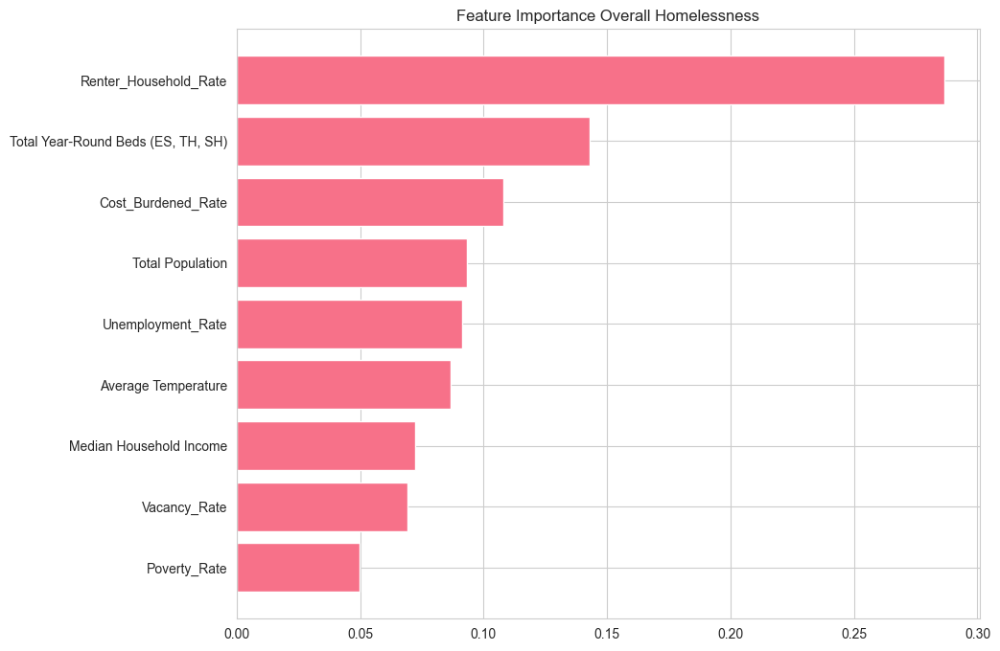

In [69]:
## 1. Overall Homelessness Prediction 

# Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y1, test_size=0.2, random_state=42)

# Get feature names
feature_names = X_train.columns if isinstance(X_train, pd.DataFrame) else [f"Feature {i}" for i in range(X_train.shape[1])]

# Train model
model = XGBRegressor(objective='reg:squarederror', random_state=42)
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Calculate metrics
mse1 = mean_squared_error(y_test, y_pred)
rmse1 = np.sqrt(mse1)
r21 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse1:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse1:.2f}")
print(f"R-squared (R2): {r21:.2f}")

# Feature importance
feature_importance = model.feature_importances_
sorted_idx = feature_importance.argsort()  

# Plot sorted feature importances
plt.figure(figsize=(10, 8))
plt.barh([feature_names[i] for i in sorted_idx], feature_importance[sorted_idx])
plt.title("Feature Importance Overall Homelessness")
plt.show()

Mean Squared Error (MSE): 0.18
Root Mean Squared Error (RMSE): 0.43
R-squared (R2): 0.42


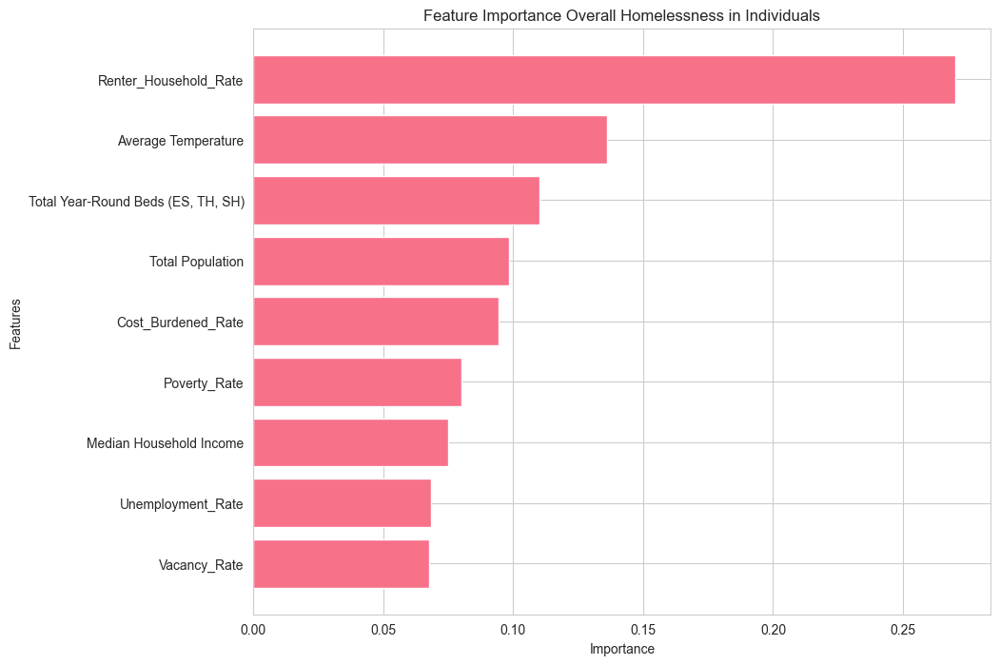

In [70]:
## 2. Overall Homelessness in Individuals Prediction

X_train, X_test, y_train, y_test = train_test_split(X, y2, test_size=0.2, random_state=42)

model = XGBRegressor(objective='reg:squarederror', random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse2 = mean_squared_error(y_test, y_pred)
rmse2 = np.sqrt(mse2)
r22 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse2:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse2:.2f}")
print(f"R-squared (R2): {r22:.2f}")

feature_importance = model.feature_importances_
sorted_idx = feature_importance.argsort()  # Sort in ascending order

# Plot sorted feature importances
plt.figure(figsize=(10, 8))
plt.barh(X.columns[sorted_idx], feature_importance[sorted_idx])
plt.title("Feature Importance Overall Homelessness in Individuals")
plt.xlabel("Importance")
plt.ylabel("Features")
plt.show()

Mean Squared Error (MSE): 0.14
Root Mean Squared Error (RMSE): 0.38
R-squared (R2): 0.18


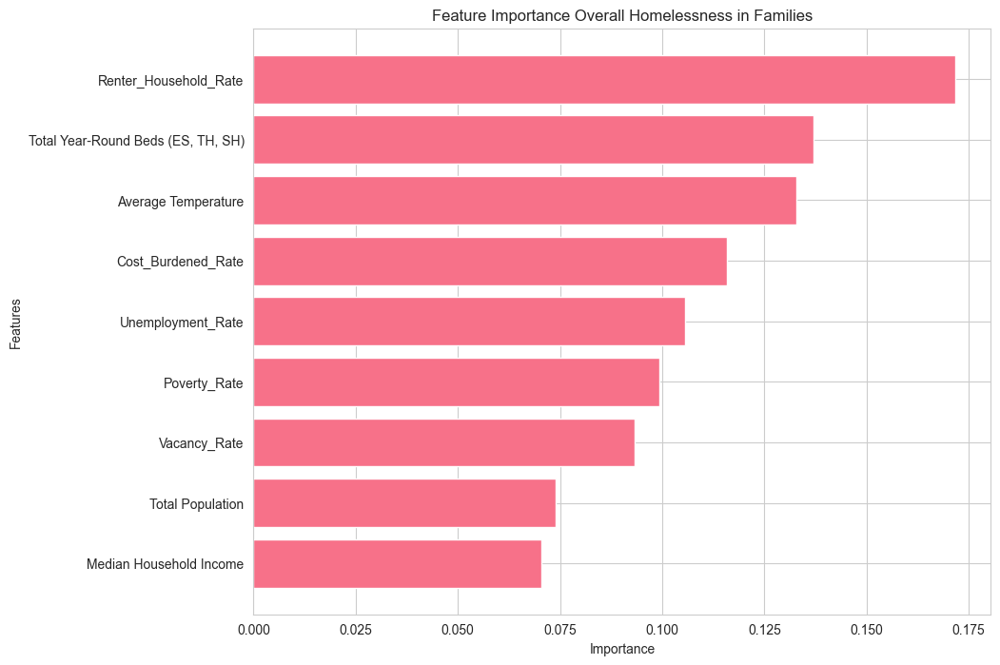

In [71]:
## 3. Overall Homelessness in Families Prediction 

X_train, X_test, y_train, y_test = train_test_split(X, y3, test_size=0.2, random_state=42)
model = XGBRegressor(objective='reg:squarederror', random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse3 = mean_squared_error(y_test, y_pred)
rmse3 = np.sqrt(mse3)
r23 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse3:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse3:.2f}")
print(f"R-squared (R2): {r23:.2f}")

feature_importance = model.feature_importances_
sorted_idx = feature_importance.argsort()  # Sort in ascending order

# Plot sorted feature importances
plt.figure(figsize=(10, 8))
plt.barh(X.columns[sorted_idx], feature_importance[sorted_idx])
plt.title("Feature Importance Overall Homelessness in Families")
plt.xlabel("Importance")
plt.ylabel("Features")
plt.show()

Mean Squared Error (MSE): 0.18
Root Mean Squared Error (RMSE): 0.42
R-squared (R2): 0.45


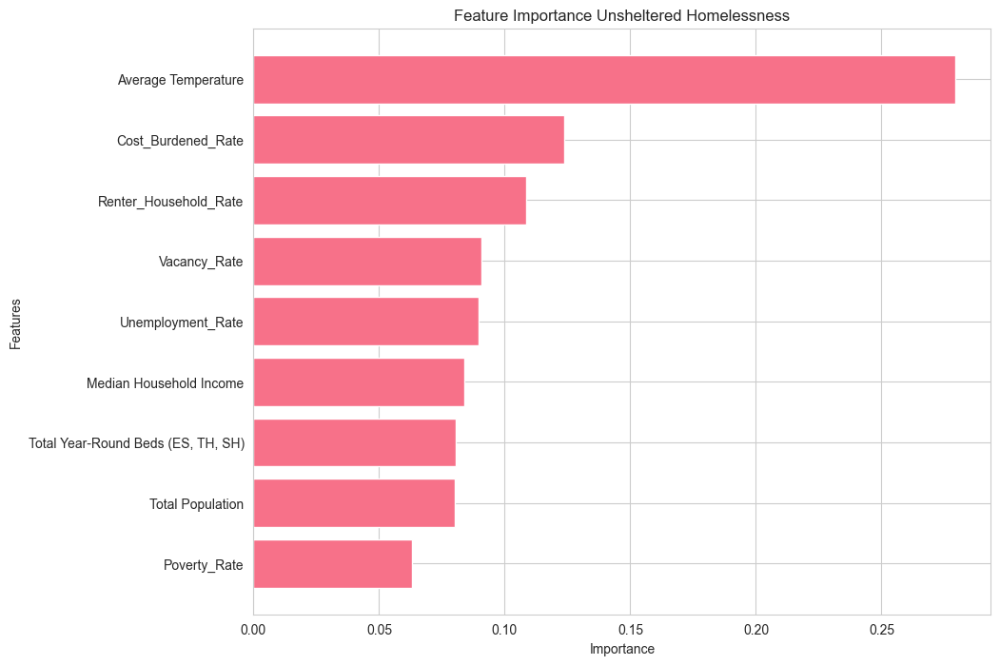

In [72]:
## 4. Overall Homelessness in Unsheltered Prediction 

X_train, X_test, y_train, y_test = train_test_split(X, y4, test_size=0.2, random_state=42)
model = XGBRegressor(objective='reg:squarederror', random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

mse4 = mean_squared_error(y_test, y_pred)
rmse4 = np.sqrt(mse4)
r24 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse4:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse4:.2f}")
print(f"R-squared (R2): {r24:.2f}")

feature_importance = model.feature_importances_
sorted_idx = feature_importance.argsort()  # Sort in ascending order

# Plot sorted feature importances
plt.figure(figsize=(10, 8))
plt.barh(X.columns[sorted_idx], feature_importance[sorted_idx])
plt.title("Feature Importance Unsheltered Homelessness")
plt.xlabel("Importance")
plt.ylabel("Features")
plt.show()

Mean Squared Error (MSE): 0.17
Root Mean Squared Error (RMSE): 0.41
R-squared (R2): 0.28


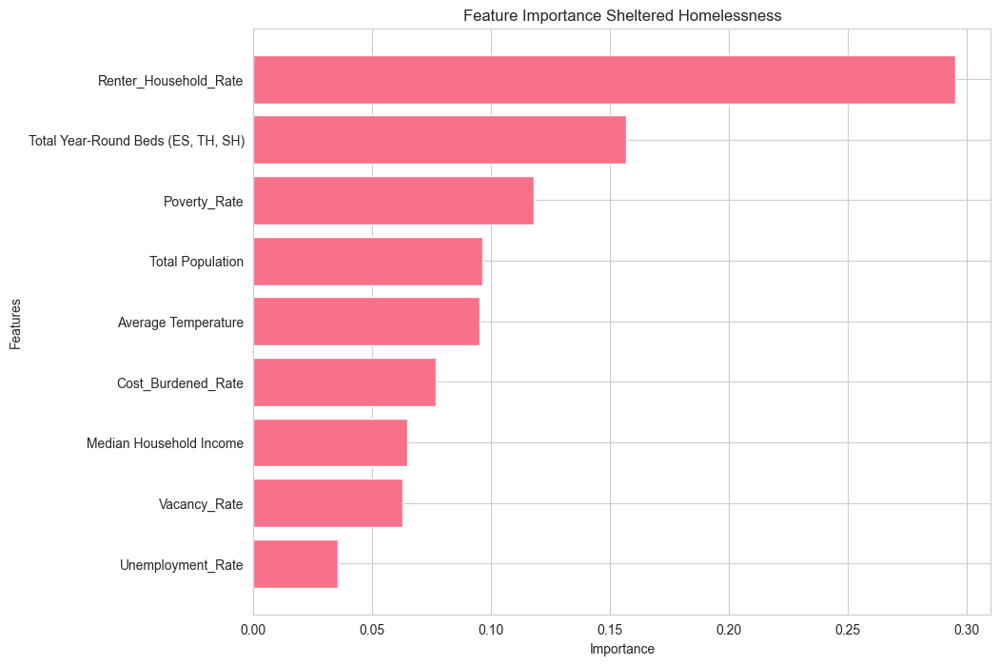

In [73]:
## 5. Overall Homelessness in Sheltered Prediction

X_train, X_test, y_train, y_test = train_test_split(X, y5, test_size=0.2, random_state=42)
model = XGBRegressor(objective='reg:squarederror', random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

mse5 = mean_squared_error(y_test, y_pred)
rmse5 = np.sqrt(mse5)
r25 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse5:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse5:.2f}")
print(f"R-squared (R2): {r25:.2f}")

feature_importance = model.feature_importances_
sorted_idx = feature_importance.argsort()  # Sort in ascending order

# Plot sorted feature importances
plt.figure(figsize=(10, 8))
plt.barh(X.columns[sorted_idx], feature_importance[sorted_idx])
plt.title("Feature Importance Sheltered Homelessness")
plt.xlabel("Importance")
plt.ylabel("Features")
plt.show()

### Team member - Renjie Fan - Random Forest

Results for Overall_Homeless_Per_Capita:
  RMSE: 0.000995618797348879
  R2: 0.7845734157138843
Results for Overall_Homeless_Individuals_Per_Capita:
  RMSE: 0.0007755122818791045
  R2: 0.7818283015790718
Results for Overall_Homeless_People_in_Families_Per_Capita:
  RMSE: 0.0003825294297427024
  R2: 0.8157670163789086
Results for Unsheltered_Homeless_Per_Capita:
  RMSE: 0.0007904680476420108
  R2: 0.6994748687991253
Results for Sheltered_Homeless_Per_Capita:
  RMSE: 0.0004715341193337176
  R2: 0.8856969302219299


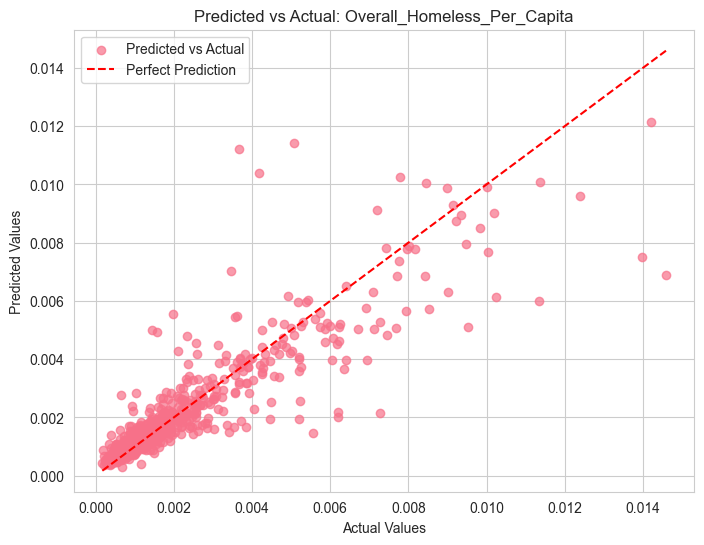

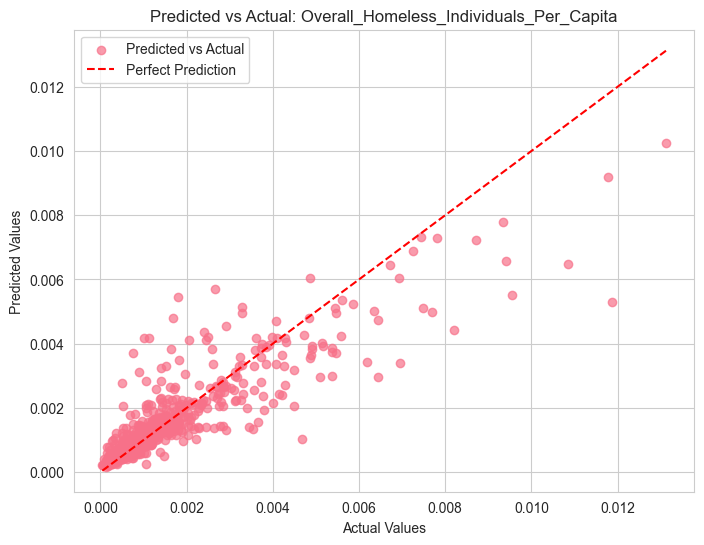

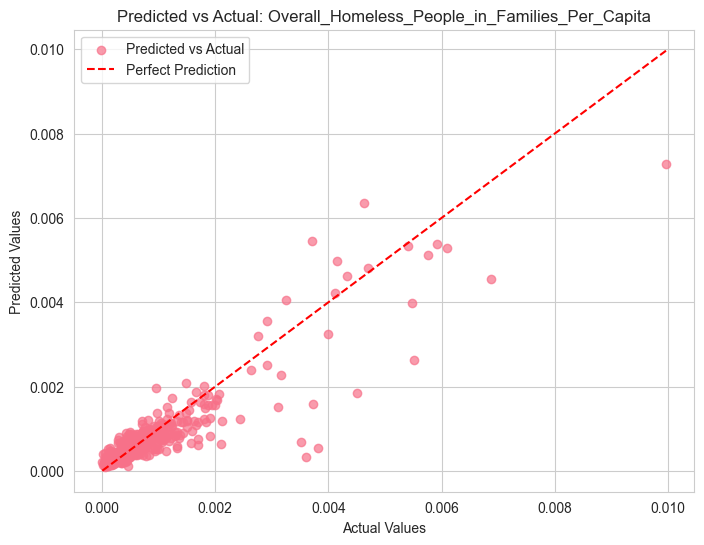

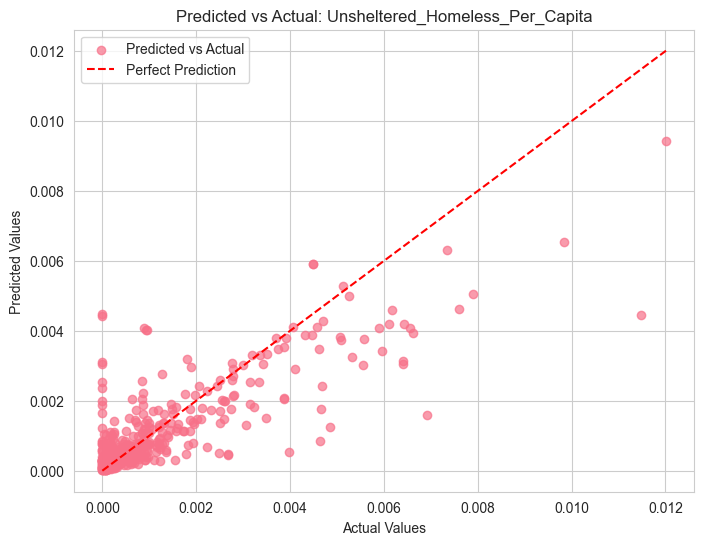

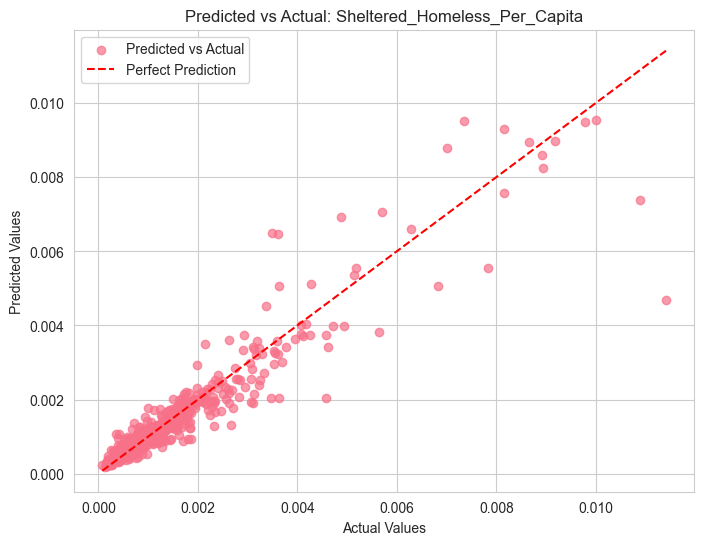

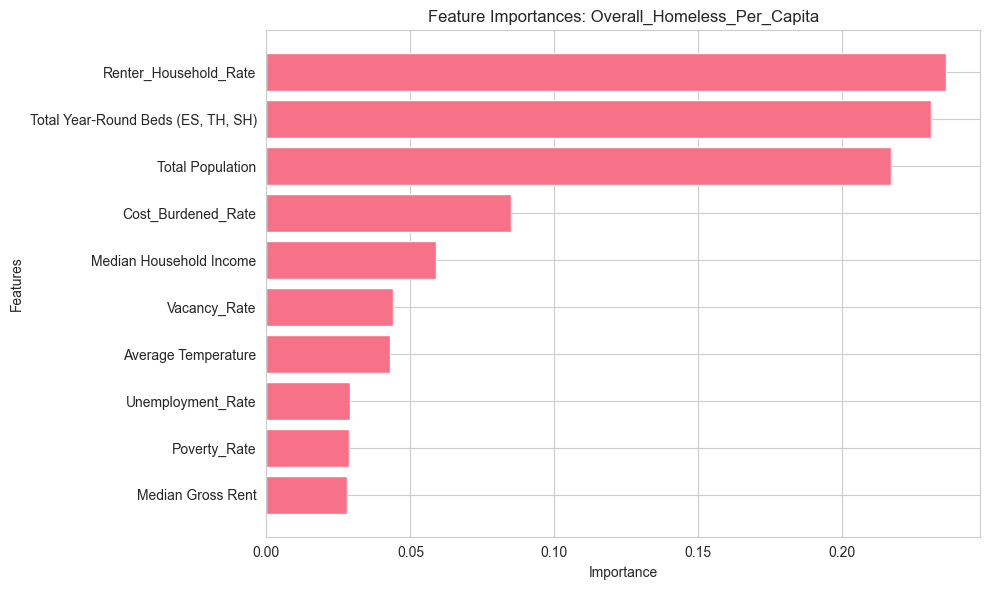

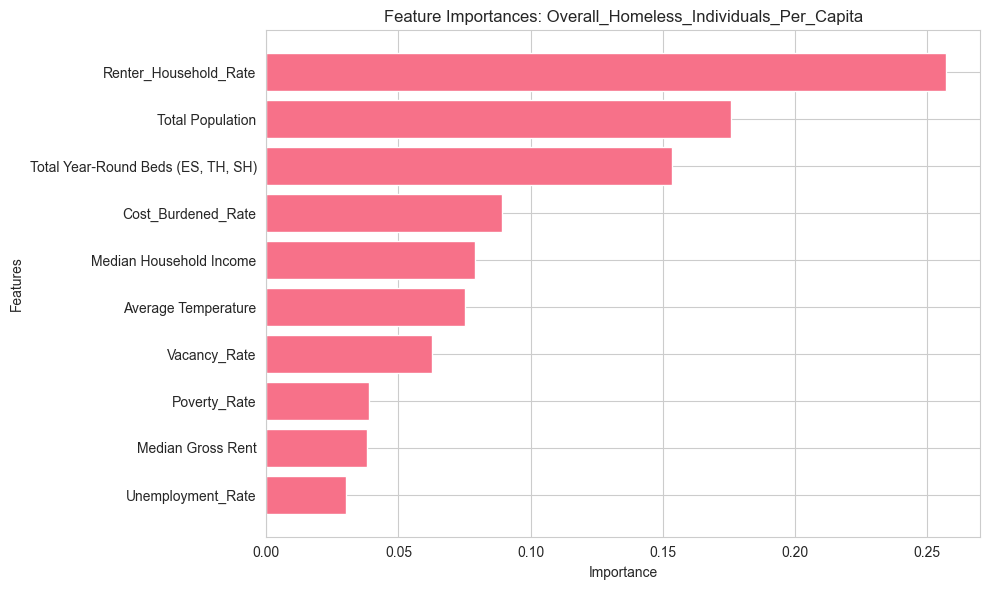

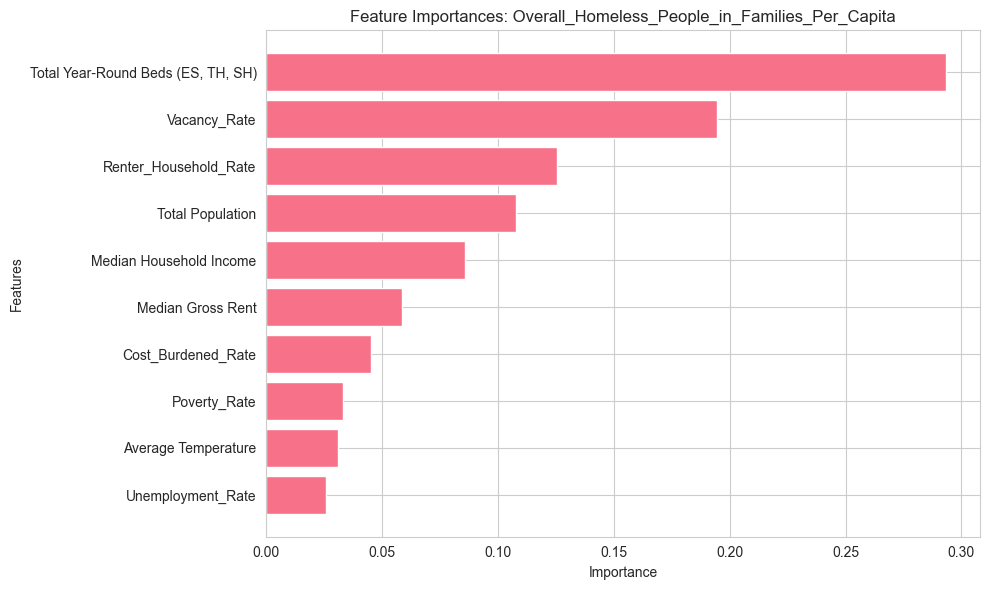

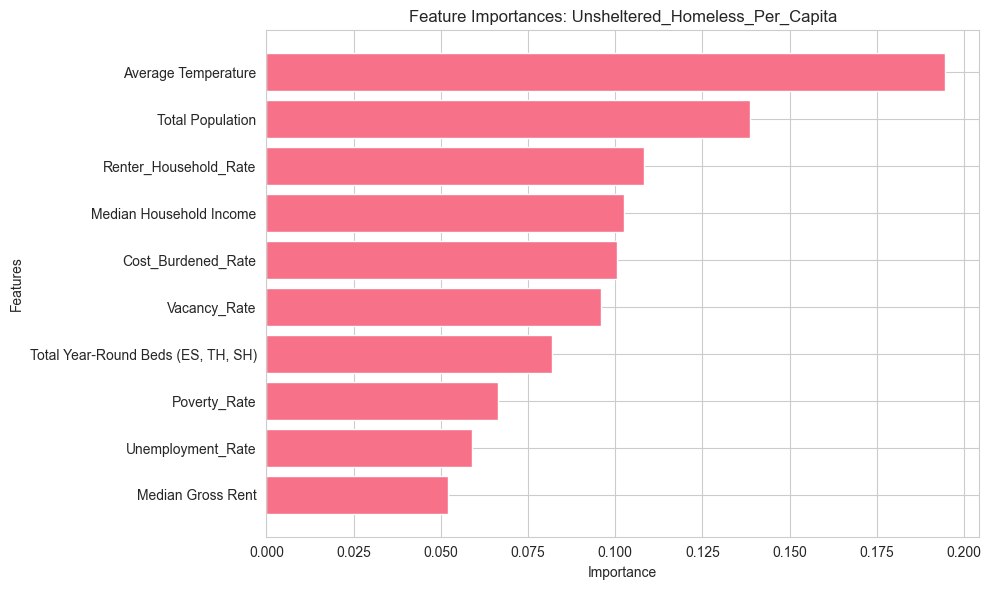

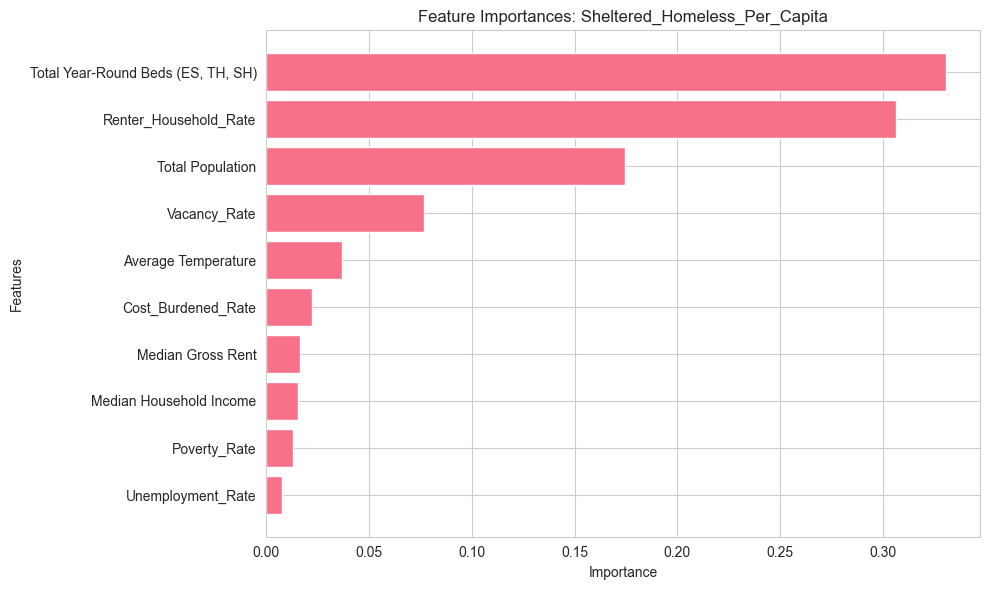

In [74]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

# Load the dataset
file_path = r"/Users/samritha/Downloads/Final_Dataset.csv"
data = pd.read_csv(file_path)

# Define predictor and target variables
predictors = [
    "Total Population",
    "Median Gross Rent",
    "Median Household Income",
    "Poverty_Rate",
    "Vacancy_Rate",
    "Renter_Household_Rate",
    "Cost_Burdened_Rate",
    "Unemployment_Rate",
    "Total Year-Round Beds (ES, TH, SH)",
    "Average Temperature"
]

targets = [
    "Overall_Homeless_Per_Capita",
    "Overall_Homeless_Individuals_Per_Capita",
    "Overall_Homeless_People_in_Families_Per_Capita",
    "Unsheltered_Homeless_Per_Capita",
    "Sheltered_Homeless_Per_Capita"
]

# Drop rows with missing values for simplicity
data_cleaned = data.dropna(subset=predictors + targets)

# Split data into features (X) and targets (y)
X = data_cleaned[predictors]
y = data_cleaned[targets]

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train RandomForest models for each target
models = {}
predictions = {}
results = {}

for target in targets:
    model = RandomForestRegressor(random_state=42, n_estimators=100)
    model.fit(X_train, y_train[target])
    y_pred = model.predict(X_test)
    
    # Store the model and predictions
    models[target] = model
    predictions[target] = y_pred
    
    # Evaluate model performance
    rmse = np.sqrt(mean_squared_error(y_test[target], y_pred))
    r2 = r2_score(y_test[target], y_pred)
    results[target] = {"RMSE": rmse, "R2": r2}

# Print results
for target, metrics in results.items():
    print(f"Results for {target}:")
    for metric, value in metrics.items():
        print(f"  {metric}: {value}")

# Visualize predictions vs. actual values for each target
for target in targets:
    y_actual = y_test[target]
    y_pred = predictions[target]

    # Scatter plot
    plt.figure(figsize=(8, 6))  # Adjusted for vertical orientation
    plt.scatter(y_actual, y_pred, alpha=0.7, label='Predicted vs Actual')
    
    # Line of perfect prediction
    line = np.linspace(min(y_actual.min(), y_pred.min()), max(y_actual.max(), y_pred.max()), 100)
    plt.plot(line, line, color='red', linestyle='--', label='Perfect Prediction')

    plt.title(f"Predicted vs Actual: {target}")
    plt.xlabel("Actual Values")
    plt.ylabel("Predicted Values")
    plt.legend()
    plt.grid(True)
    plt.show()

# Visualize feature importances for each target
for target in targets:
    model = models[target]
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    
    plt.figure(figsize=(10, 6))  # Adjusted for vertical orientation
    plt.barh(range(X.shape[1]), importances[indices], align="center")
    plt.yticks(range(X.shape[1]), X.columns[indices])
    plt.gca().invert_yaxis()  # Invert y-axis for descending order
    plt.title(f"Feature Importances: {target}")
    plt.xlabel("Importance")
    plt.ylabel("Features")
    plt.tight_layout()
    plt.show()

### Team member - Kunshu Yang - Random Forest


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder

# 读取数据
data = pd.read_csv(r'C:\Users\ykks\Desktop\zuoye\spark\model\Merged_Data.csv')

# 过滤只包含 2010-2023 年的数据
data = data[(data['Year'] >= 2010) & (data['Year'] <= 2023)]

# 检查数据，去除缺失值
print(data.info())
data = data.dropna()

# 对非数值型特征进行编码
label_encoders = {}
for column in data.select_dtypes(include=['object']).columns:
    le = LabelEncoder()
    data[column] = le.fit_transform(data[column])
    label_encoders[column] = le

# 定义不同的目标变量列表
targets = ['Overall Homeless', 'Overall Homeless Individuals', 'Overall Homeless People in Families', 'Unsheltered Homeless', 'Sheltered Total Homeless']

# 创建空的结果列表用于存储每个目标变量的评估结果
results = []

# 对每个目标变量进行预测和评估
for target in targets:
    # 特征和目标变量选择
    X = data.drop(columns=targets)
    y = data[target]
    
    # 划分训练集和测试集
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # 创建随机森林回归模型
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    
    # 训练模型
    model.fit(X_train, y_train)
    
    # 进行预测
    y_pred = model.predict(X_test)
    
    # 评估模型性能
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    results.append((target, mse, r2))

# 打印所有目标变量的评估结果
for target, mse, r2 in results:
    print(f"{target} - Mean Squared Error: {mse:.2e}, R-squared: {r2:.4f}")

### Team member - Shiheng Xu - Linear Regression



Overall Homeless
Mean Squared Error (MSE): 0.15
Root Mean Squared Error (RMSE): 0.38
R-squared (R2): 0.39


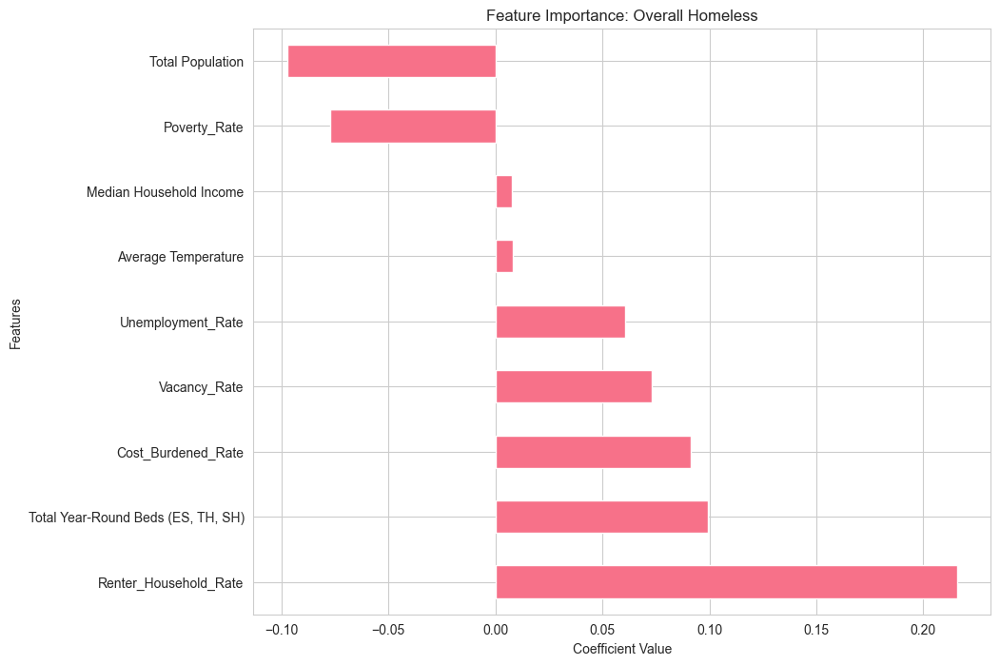


Overall Homeless Individuals
Mean Squared Error (MSE): 0.14
Root Mean Squared Error (RMSE): 0.37
R-squared (R2): 0.36


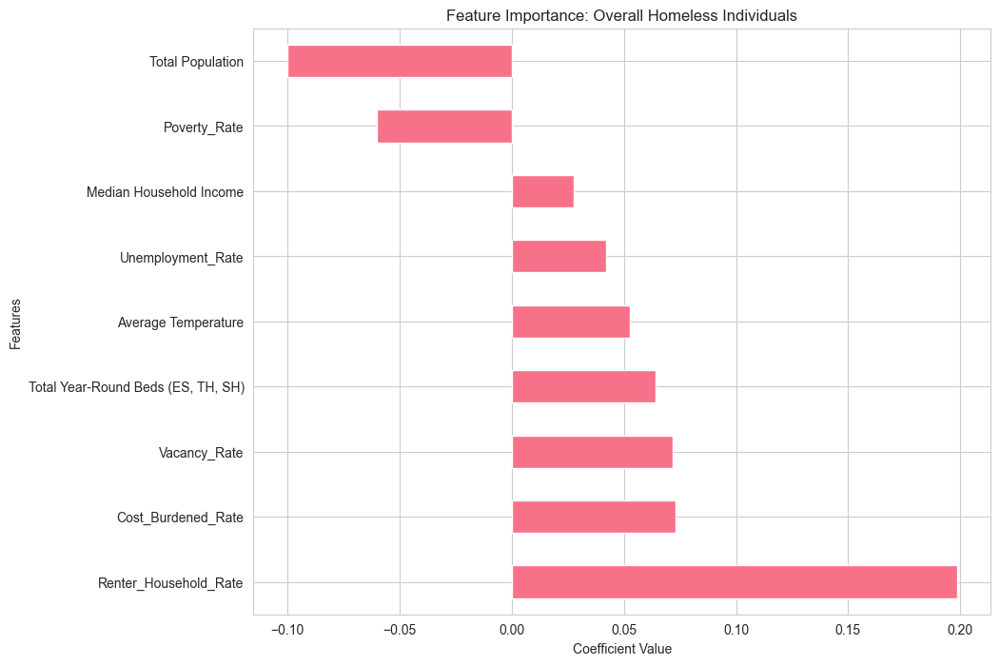


Overall Homeless People in Families
Mean Squared Error (MSE): 0.06
Root Mean Squared Error (RMSE): 0.24
R-squared (R2): 0.29


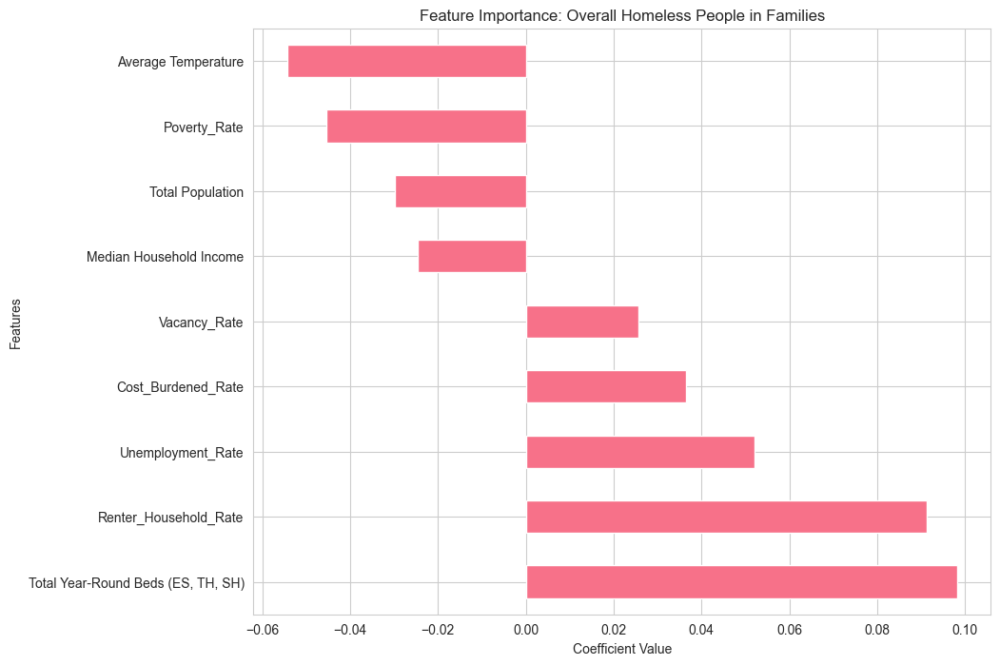


Unsheltered Homeless
Mean Squared Error (MSE): 0.16
Root Mean Squared Error (RMSE): 0.41
R-squared (R2): 0.30


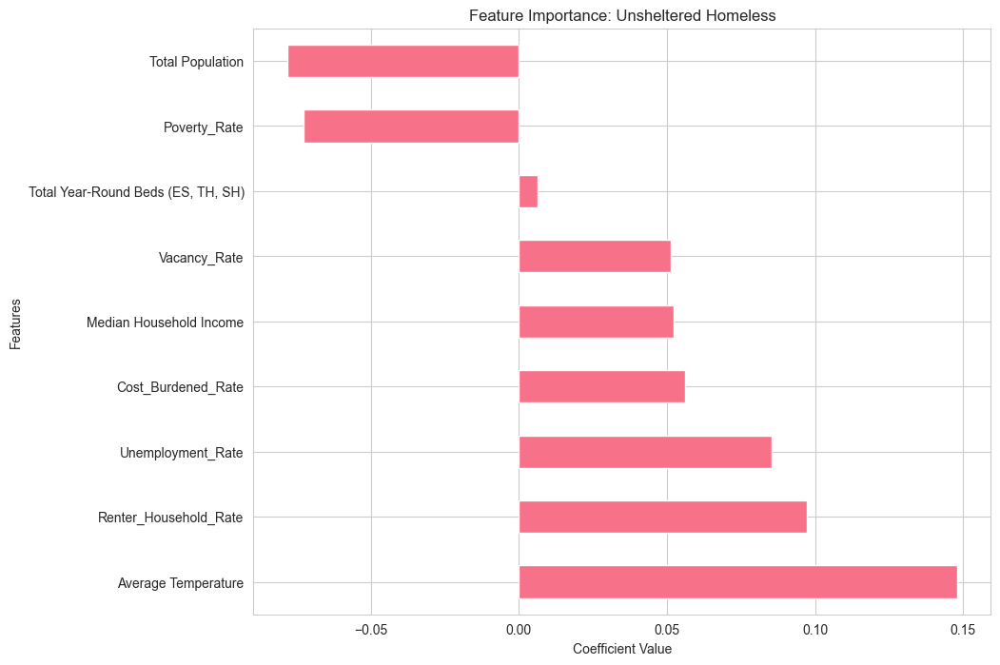


Sheltered Homeless
Mean Squared Error (MSE): 0.08
Root Mean Squared Error (RMSE): 0.28
R-squared (R2): 0.44


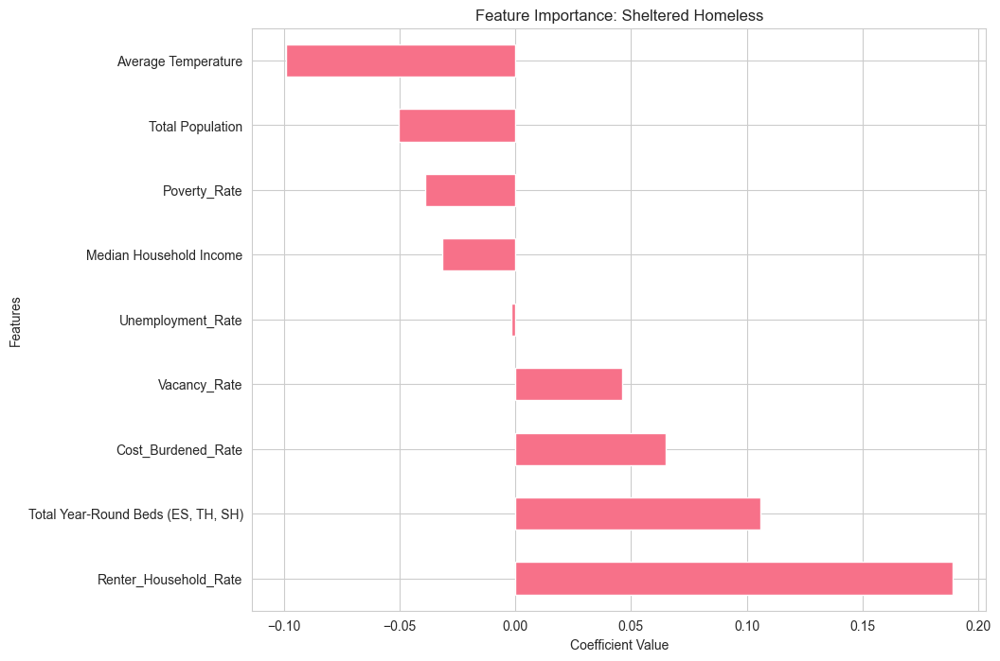

In [75]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

# Load the dataset
file_path = '/Users/samritha/Downloads/Final_Dataset.csv'
data = pd.read_csv(file_path)

# Replace placeholder values (e.g., '.') with NaN and convert data to float64
data.replace('.', float('nan'), inplace=True)
data = data.astype('float64')

# Define predictors (X) and target variables (y)
# Drop irrelevant columns from X
X = data.drop(columns=[
    'Median Gross Rent', 'Overall Homeless', 'Overall Homeless Individuals',
    'Overall Homeless People in Families', 'Unsheltered Homeless', 'Sheltered Total Homeless',
    'Overall_Homeless_Per_Capita', 'Overall_Homeless_Individuals_Per_Capita',
    'Overall_Homeless_People_in_Families_Per_Capita', 'Unsheltered_Homeless_Per_Capita',
    'Sheltered_Homeless_Per_Capita'
])

# Scale target variables by multiplying them by 1000
y1 = data['Overall_Homeless_Per_Capita'] * 1000
y2 = data['Overall_Homeless_Individuals_Per_Capita'] * 1000
y3 = data['Overall_Homeless_People_in_Families_Per_Capita'] * 1000
y4 = data['Unsheltered_Homeless_Per_Capita'] * 1000
y5 = data['Sheltered_Homeless_Per_Capita'] * 1000

# Handle missing values in the target variables by filling them with 0
y1.fillna(0, inplace=True)
y2.fillna(0, inplace=True)
y3.fillna(0, inplace=True)
y4.fillna(0, inplace=True)
y5.fillna(0, inplace=True)

# Apply log transformation to target variables for normalization
y1 = np.log1p(y1)
y2 = np.log1p(y2)
y3 = np.log1p(y3)
y4 = np.log1p(y4)
y5 = np.log1p(y5)

# Standardize predictor variables (X)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Convert back to DataFrame to retain column names
X = pd.DataFrame(X_scaled, columns=X.columns)

# Remove rows with NaN values in predictors or targets
X_cleaned = X.dropna()
y_cleaned = [y1, y2, y3, y4, y5]
X_cleaned = X_cleaned.loc[X_cleaned.index.intersection(y1.index)]

# Train and evaluate models for each target variable
target_variables = [y1, y2, y3, y4, y5]
target_names = [
    "Overall Homeless",
    "Overall Homeless Individuals",
    "Overall Homeless People in Families",
    "Unsheltered Homeless",
    "Sheltered Homeless"
]

for y, name in zip(target_variables, target_names):
    # Ensure the target variable aligns with the cleaned predictor data
    y_aligned = y.loc[X_cleaned.index]

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_cleaned, y_aligned, test_size=0.2, random_state=42)
    
    # Train the Linear Regression model
    model = LinearRegression()
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Calculate metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    
    # Display results
    print(f"\n{name}")
    print(f"Mean Squared Error (MSE): {mse:.2f}")
    print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
    print(f"R-squared (R2): {r2:.2f}")
    
    # Feature importance analysis using model coefficients
    coef_importance = pd.Series(model.coef_, index=X.columns)
    coef_importance_sorted = coef_importance.sort_values(ascending=False)

    # Plot sorted feature importances
    plt.figure(figsize=(10, 8))
    coef_importance_sorted.plot(kind='barh')
    plt.title(f"Feature Importance: {name}")
    plt.xlabel("Coefficient Value")
    plt.ylabel("Features")
    plt.show()